# <center> <img src="https://www.isel.pt/sites/default/files/001_imagens_isel/Logotipos/ISEL%202025/01_ISEL-Logotipo-RGB_Horizontal-Compacto-900.png" alt="ISEL Logo" width="800"/> </center>
# <center> Processamento de Imagem e Visão </center>
# <center> Semestre 25/26 </center>
### <center> Trabalho prático 1 </center>

Trabalho realizado por:
* Carlos Simões, número <b> 51696 </b>
* Rodrigo Silva, número <b> 51743 </b>

<b> Turma 51D - Docente Pedro Mendes Jorge </b>

## **Índice**

- [Introdução](#introducao)
  - [Contexto](#contexto)
  - [Objetivo](#objetivo)
- [Processo](#processo)
- [Imports e variáveis necessárias](#imports-e-variáveis-necessárias)
- [0. Funções Necessárias e Histogramas](#0-funções-necessárias-e-histogramas)
  - [Justificação do código](#justificação-do-código)
- [1. Binarização](#1-binarização)
  - [Método de Otsu](#método-de-otsu)
  - [Justificação do código](#justificação-do-código)
- [2. Operações Morfológicas](#2-operações-morfológicas)
  - [Justificação do código](#justificação-do-código-1)
- [3. Extração de componentes conexos](#3-extração-de-componentes-conexos)
  - [Justificação do código](#justificação-do-código-2)
- [4. Extração de propriedades](#4-extração-de-propriedades)
  - [Justificação do código](#justificação-do-código-3)
- [5. Classificação de objetos](#5-classificação-de-objetos)
  - [Justificação do código](#justificação-do-código-4)
- [6. Teste das funções](#6-teste-das-funções)
- [Conclusões](#conclusões)
- [Bibliografia](#bibliografia)

## **Introdução**

### Contexto

No âmbito da Unidade Curricular de Processamento de Imagem e Visão, foi solicitado o desenvolvimento de um algoritmo capaz de realizar a contagem automática de peças de Lego retangulares dispostas sobre uma superfície plana.

O principal propósito deste projeto é consolidar o domínio das funcionalidades da biblioteca `OpenCV`, aplicando simultaneamente os conceitos e técnicas introduzidos nas aulas práticas, nomeadamente no que diz respeito à deteção e classificação de objetos por computador em tempo real.

### Objetivo

O objetivo consiste em conceber um algoritmo capaz de efetuar a contagem das peças de Lego retangulares — com dimensões “2x2”, “2x4”, “2x6” e “2x8” — dispostas sobre uma mesa de superfície clara e homogénea, sendo estas observadas por uma câmara fixa num tripé, cuja orientação é ajustada de forma a manter o plano do sensor paralelo ao plano da mesa.

O algoritmo deverá apresentar robustez face a diversas perturbações, nomeadamente:
- presença de outras peças de Lego no campo de visão;
- formação de sombras;
- contacto ou sobreposição parcial entre peças

## **Processo**

O processo de análise inicia-se com a **binarização da imagem**, etapa responsável por separar o fundo das regiões de interesse, convertendo a imagem original numa representação a preto e branco que facilita a distinção entre as peças de Lego e a mesa.

Segue-se a aplicação de **operações morfológicas**, cujo objetivo é eliminar ruído residual, corrigir imperfeições e refinar as fronteiras dos objetos, garantindo que as peças se apresentem bem definidas e isoladas.

Posteriormente, procede-se à **extração dos componentes conexos**, que consiste em identificar e rotular cada região contínua de píxeis, permitindo distinguir cada peça individualmente.

Com base nestas regiões, é então realizada a **extração de propriedades**, tais como área, perímetro, razão de aspeto e orientação, parâmetros essenciais para caracterizar cada objeto de forma quantitativa.

Por fim, o sistema executa a **classificação das peças**, atribuindo a cada uma uma categoria correspondente ao seu tipo (2x2, 2x4, 2x6 ou 2x8), e efetua a contagem final, apresentando os resultados de forma organizada e compreensível.

## ***Imports* e variáveis necessárias**

In [11]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import os

file_dir = "treino/"

image_files = [f for f in os.listdir(file_dir) if f.lower().endswith('.jpg')]

## **0. Funções Necessárias e Histogramas**

imagem: lego01.jpg
Dimensões da imagem lego01.jpg: (530, 706, 3)


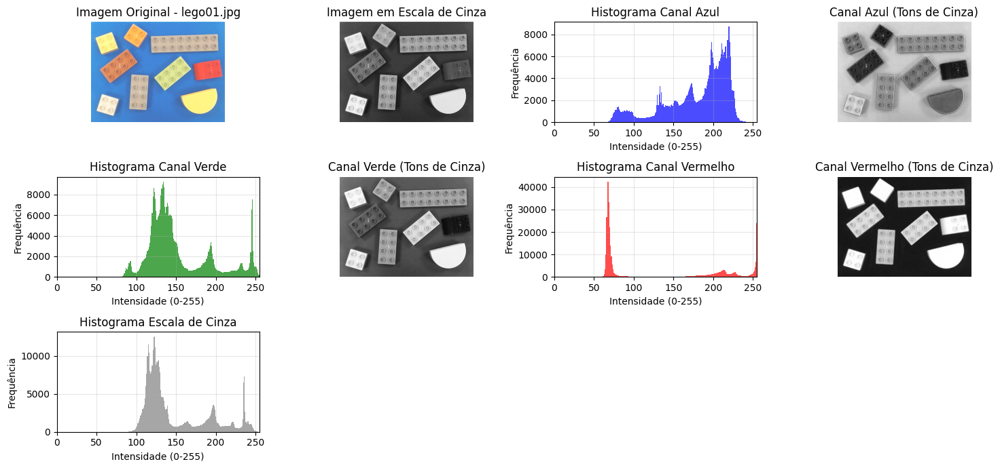

imagem: lego02.jpg
Dimensões da imagem lego02.jpg: (530, 706, 3)


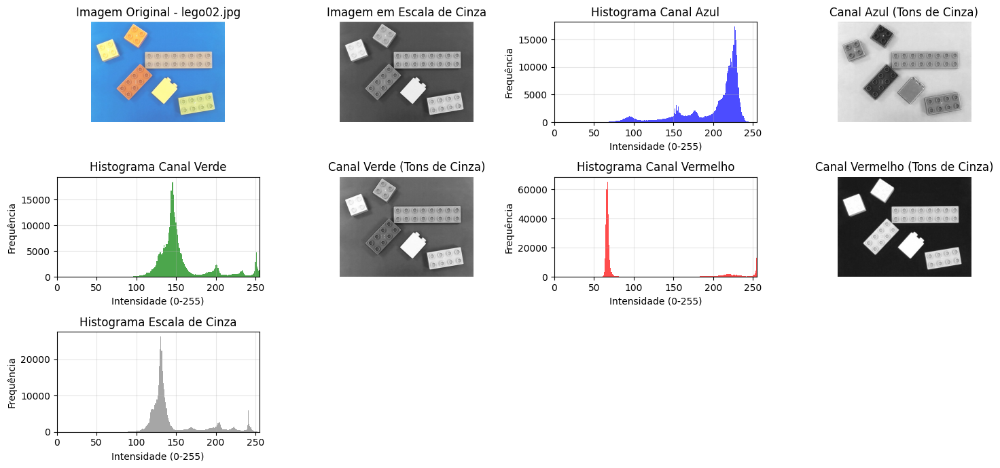

imagem: lego04.jpg
Dimensões da imagem lego04.jpg: (530, 706, 3)


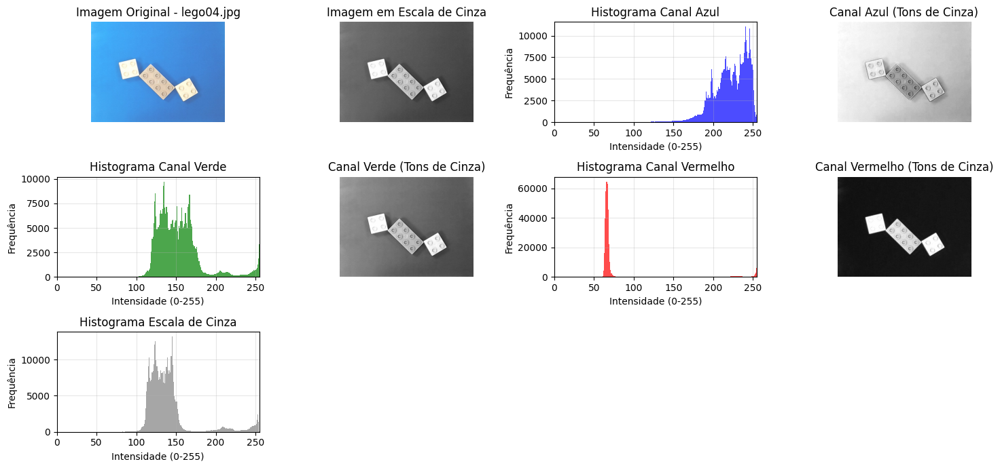

imagem: lego09.jpg
Dimensões da imagem lego09.jpg: (530, 706, 3)


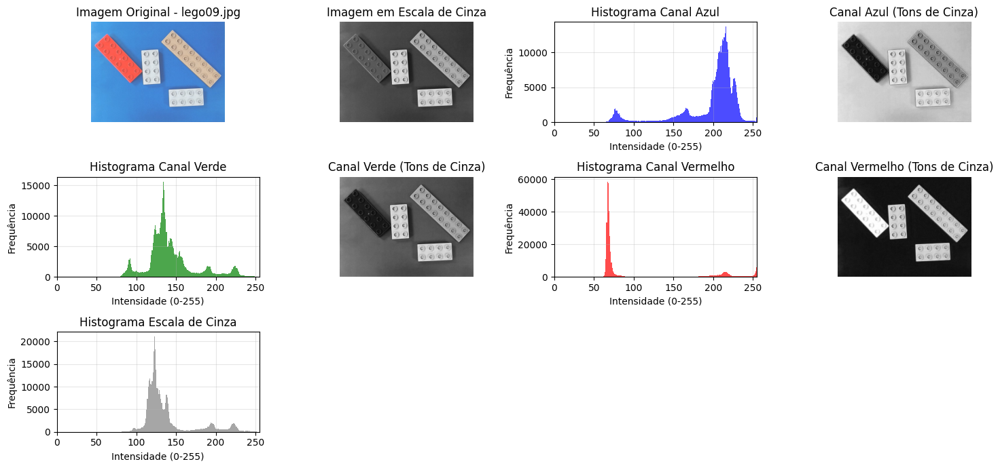

imagem: lego10.jpg
Dimensões da imagem lego10.jpg: (530, 706, 3)


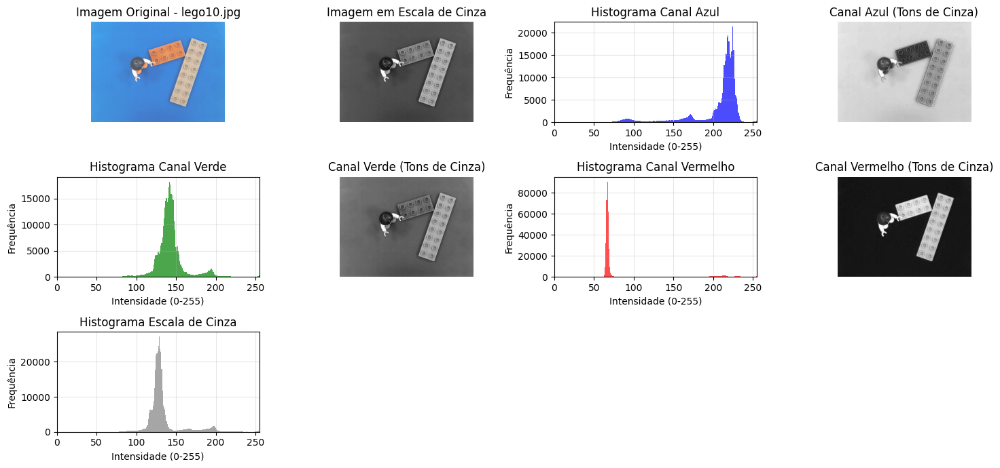

imagem: lego11.jpg
Dimensões da imagem lego11.jpg: (525, 706, 3)


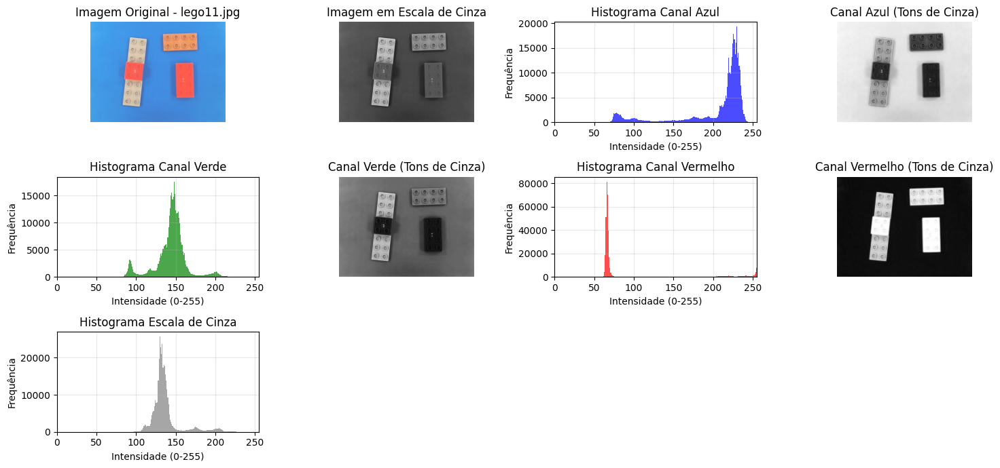

imagem: lego12.jpg
Dimensões da imagem lego12.jpg: (525, 706, 3)


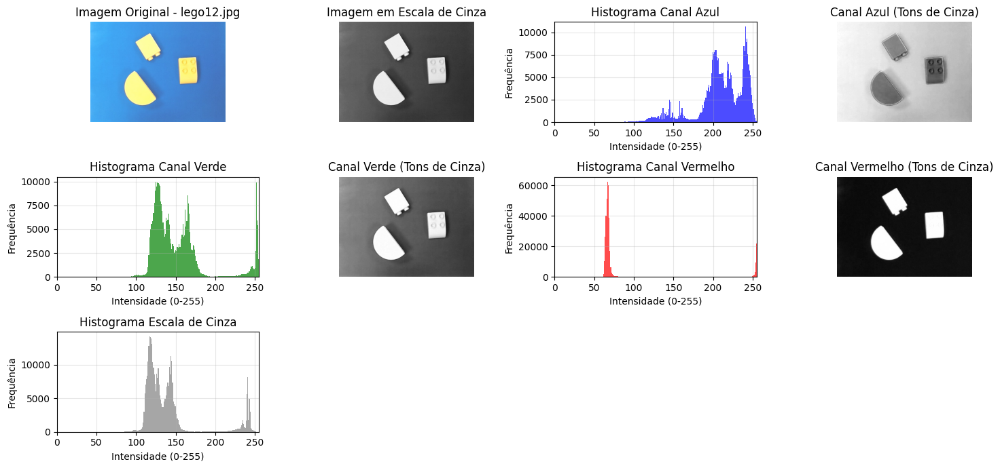

imagem: lego13.jpg
Dimensões da imagem lego13.jpg: (525, 706, 3)


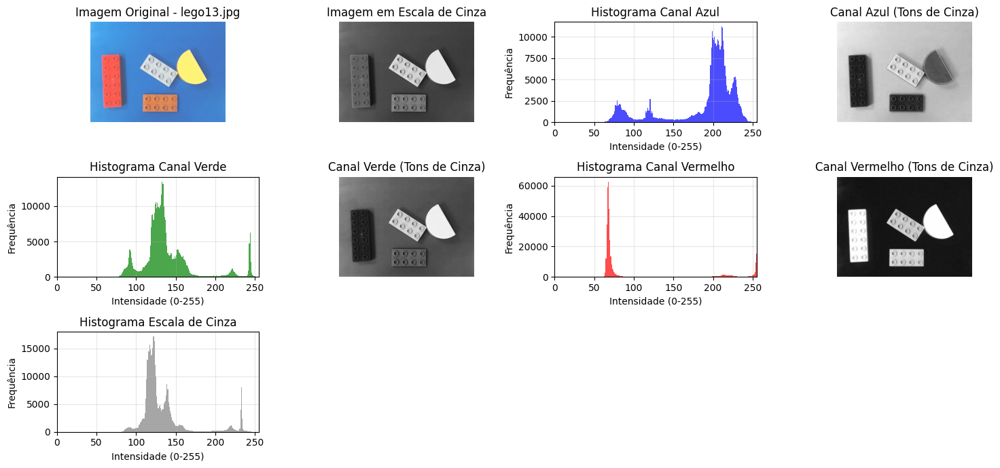

imagem: lego21.jpg
Dimensões da imagem lego21.jpg: (530, 706, 3)


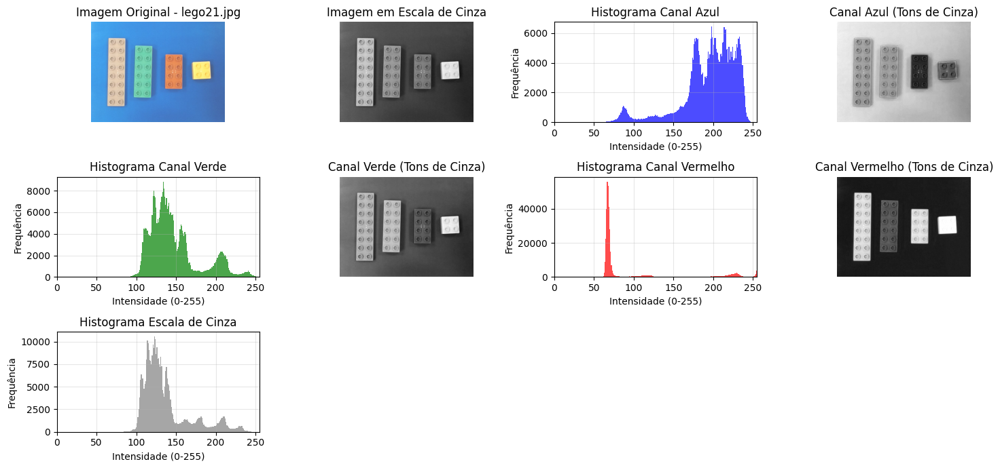

imagem: lego22.jpg
Dimensões da imagem lego22.jpg: (530, 706, 3)


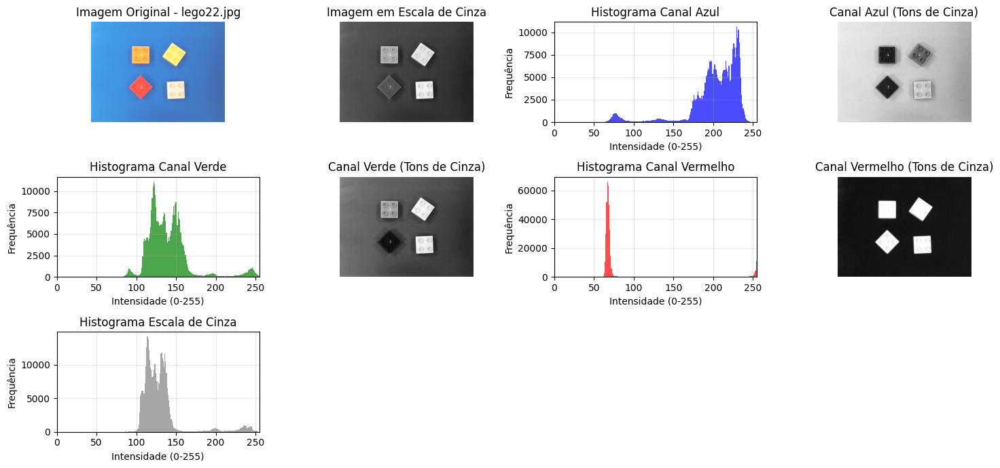

imagem: lego23.jpg
Dimensões da imagem lego23.jpg: (530, 706, 3)


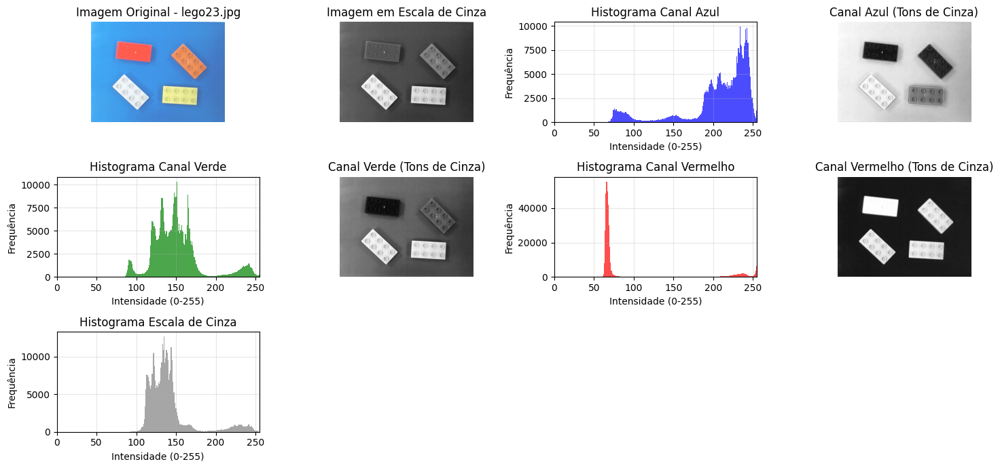

imagem: lego25.jpg
Dimensões da imagem lego25.jpg: (530, 706, 3)


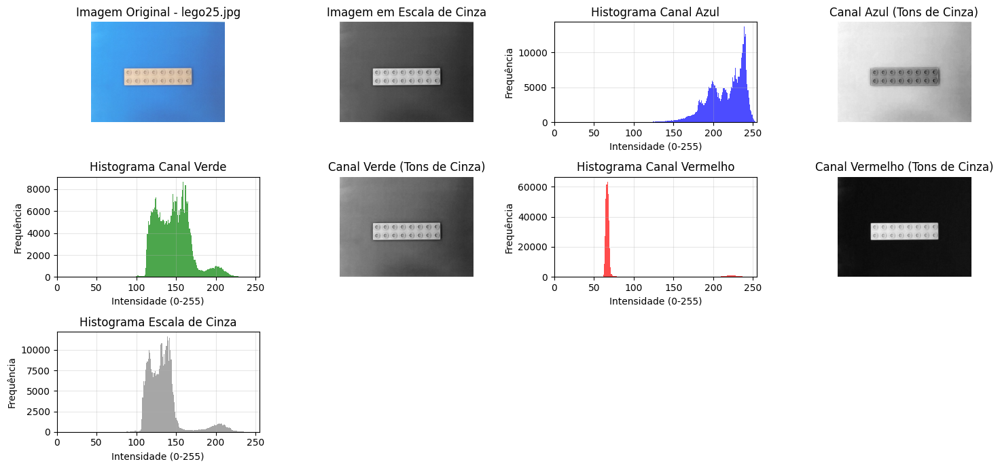

imagem: lego30.jpg
Dimensões da imagem lego30.jpg: (530, 706, 3)


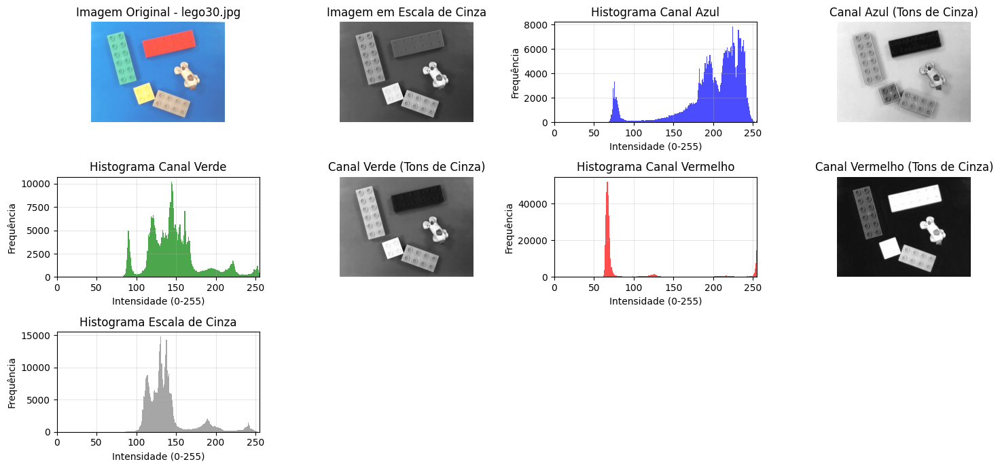

imagem: lego32.jpg
Dimensões da imagem lego32.jpg: (530, 706, 3)


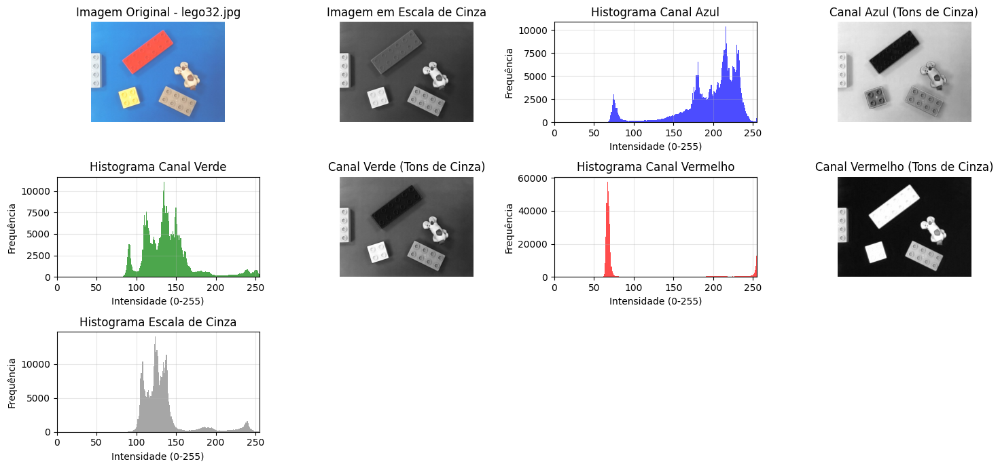

In [12]:
def leitura_imagem(img_name):
    """
    Esta função lê uma imagem de um diretório anteriormente definido.
    Retorna a imagem lida.
    """
    img = cv.imread(file_dir + img_name)
    return img

def separar_canais(img):
    """
    Esta função separa os canais de cor BGR de uma imagem.
    Retorna os canais azul, verde e vermelho.
    """
    b = img[:, :, 0]  # Canal azul
    g = img[:, :, 1]  # Canal verde
    r = img[:, :, 2]  # Canal vermelho
    return b, g, r

def histograma_cinza_tres_canais(img_name):
    """
    Esta função calcula e exibe o histograma da imagem nos 3 canais de cor.
    """
    # ler a imagem original em cores para calcular os histogramas dos canais RGB
    img_original = leitura_imagem(img_name)

    # converter a imagem para escala de cinza
    gray = cv.cvtColor(img_original, cv.COLOR_BGR2GRAY)
    
    # separar os canais BGR
    b, g, r = separar_canais(img_original)
    channels = [b, g, r]
    
    # arrays para cores e nomes dos canais
    colorChannels = ('blue', 'green', 'red')
    colorNames = np.array(['Azul', 'Verde', 'Vermelho'])
    val_quantificacao = np.arange(0, 256)
    
    # calcular histogramas para cada canal
    hist_b = cv.calcHist([b], [0], None, [256], [0, 256])
    hist_g = cv.calcHist([g], [0], None, [256], [0, 256])
    hist_r = cv.calcHist([r], [0], None, [256], [0, 256])
    hist_gray = cv.calcHist([gray], [0], None, [256], [0, 256])
    
    print(f"Dimensões da imagem {img_name}:", img_original.shape)
    
    # plot principal
    plt.figure(figsize=(15, 7))
    
    # subplot 1 -> imagem original
    plt.subplot(3, 4, 1)
    plt.imshow(cv.cvtColor(img_original, cv.COLOR_BGR2RGB))
    plt.title(f'Imagem Original - {img_name}')
    plt.axis('off')
    
    # subplot 2 -> imagem em escala de cinza
    plt.subplot(3, 4, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Imagem em Escala de Cinza')
    plt.axis('off')
    
    # plot dos histogramas e canais por meio de um ciclo for
    for i, canal in enumerate(channels):
        hist = cv.calcHist([canal], [0], None, [256], [0, 256])
        
        # histograma com barras
        plt.subplot(3, 4, 3 + i*2)
        plt.bar(val_quantificacao, np.squeeze(hist), color=colorChannels[i], width=1, alpha=0.7)
        plt.title(f'Histograma Canal {colorNames[i]}')
        plt.xlabel('Intensidade (0-255)')
        plt.ylabel('Frequência')
        plt.xlim([0, 255])
        plt.grid(True, alpha=0.3)
        
        # canal em tons de cinzento
        plt.subplot(3, 4, 4 + i*2)
        plt.imshow(canal, cmap='gray')
        plt.title(f'Canal {colorNames[i]} (Tons de Cinza)')
        plt.axis('off')
    
    # histograma da imagem em escala de cinza
    plt.subplot(3, 4, 9)
    plt.bar(val_quantificacao, np.squeeze(hist_gray), color='gray', width=1, alpha=0.7)
    plt.title('Histograma Escala de Cinza')
    plt.xlabel('Intensidade (0-255)')
    plt.ylabel('Frequência')
    plt.xlim([0, 255])
    plt.grid(True, alpha=0.3)
    
    # espaço vazio para melhor organização
    plt.subplot(3, 4, 10)
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    return hist_b, hist_g, hist_r, hist_gray

for img_name in image_files:
    print(f"imagem: {img_name}")
    img = leitura_imagem(img_name)
    hist_b, hist_g, hist_r, hist_gray = histograma_cinza_tres_canais(img_name)

### Justificação do código

Pensou-se em separar os canais porque cada canal de cor contém informação específica sobre as características das peças presentes na imagem. Então, ao fazer os histogramas para cada canal de cor em todas as imagens, percebeu-se que o canal vermelho é o mais indicado para fazer a binarização, porque **apresenta o maior contraste entre as peças de Lego e o fundo da mesa**. 

O canal vermelho proporciona uma distinção mais nítida entre as intensidades dos píxeis correspondentes às peças e ao fundo, originando um histograma com dois picos distintos. Esta propriedade é essencial para o método de Otsu, o qual apresenta melhor desempenho quando existe uma separação evidente entre as duas classes de píxeis — fundo e objetos.

## **1. Binarização**

A **binarização da imagem** é o processo no qual os bits são divididos em dois grupos: 0 e 1. Habitualmente, o valor **0** é atribuído aos píxeis com intensidade inferior ao limiar definido, enquanto o valor **1** é atribuído aos píxeis com intensidade superior a esse limiar.

No contexto do nosso projeto, o resultado desta operação traduz-se numa imagem com o **fundo a preto** e as **peças a branco**, o que facilita a fase de **classificação dos objetos**, uma vez que já não é necessário distinguir entre o fundo e os elementos relevantes da imagem.

Para a implementação da binarização, foi utilizada a função **`threshold()`** da biblioteca **OpenCV**, recorrendo ao **limiar binário** e ao método de **Otsu** para determinar automaticamente o valor ótimo de separação entre as duas classes de píxeis.


### Método de Otsu

O **método de Otsu** é uma técnica automática de **determinação de limiar (threshold)** utilizada na binarização de imagens, ou seja, no processo de converter uma imagem em tons de cinzento numa imagem binária (composta apenas por píxeis pretos e brancos).

In [13]:
def converter_verde_para_branco(img):
    """
    Função que converte peças verdes para branco usando apenas canais RGB.
    
    Parâmetros:
        img: imagem original em BGR
        
    Retorna:
        img_modified: imagem com peças verdes convertidas para branco
        mask_green: máscara dos píxeis verdes detetados
    """
    # separar os canais BGR
    b, g, r = separar_canais(img)
    
    # criar máscara para identificar píxeis verdes
    # verde tem: canal G alto, canais R e B mais baixos
    # condições: G > R e G > B e G > threshold_mínimo
    threshold_green = 80  # valor mínimo para considerar verde
    
    # máscara onde o verde é dominante
    mask_green = (g > r) & (g > b) & (g > threshold_green)
    # exemplo da mask_green:
    # Para cada píxel da imagem:
    # Se g=120, r=50, b=40, threshold_green=60
    # (120 > 50) & (120 > 40) & (120 > 60)
    # True       & True       & True       = True (píxel é considerado verde)

    # # Se g=80, r=90, b=30, threshold_green=60  
    # (80 > 90) & (80 > 30) & (80 > 60)
    # False     & True      & True       = False (não é verde, vermelho domina)
    
    # criar uma cópia da imagem original
    img_modified = img.copy()
    
    # converter píxeis verdes para branco
    img_modified[mask_green] = [255, 255, 255]  # BGR: branco
    
    # converter mask_green para uint8 para visualização
    mask_green_viz = mask_green.astype(np.uint8) * 255
    
    return img_modified, mask_green_viz

### Justificação do código

O método `converter_verde_para_branco` foi implementado devido a certas peças de tons mais esverdeados, mais precisamente peças das imagens `lego21` e `lego30`, que apresentavam valores baixos no canal vermelho, resultando numa binarização inadequada quando aplicado diretamente o método de Otsu.

A função funciona da seguinte maneira:
1. Separam-se os canais de cor
2. Atribui-se um valor de limiar para a cor verde
3. Cria-se a variável `mask_green` que servirá para criar uma máscara só com tons verdes. Funciona através de condições lógicas que verificam se o canal verde é dominante (G > R e G > B) e se a sua intensidade é superior ao limiar mínimo definido, resultando numa máscara binária onde os píxeis verdes são identificados como True e os restantes como False
4. É feita uma cópia da imagem original, para preservar a imagem inicial
5. A conversão dos píxeis verdes em brancos é então feita na imagem copiada
6. Converte-se a máscara verde para se poder visualizar
7. Finalmente, devolve a imagem modificada e a máscara verde

imagem: lego01.jpg


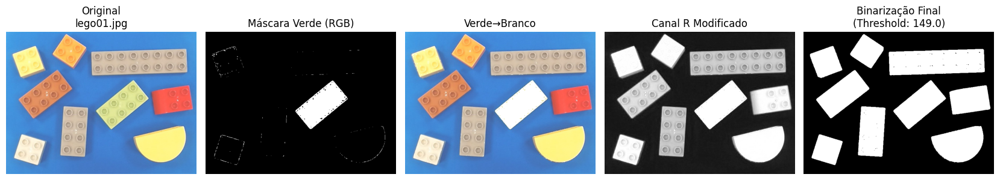

imagem: lego02.jpg


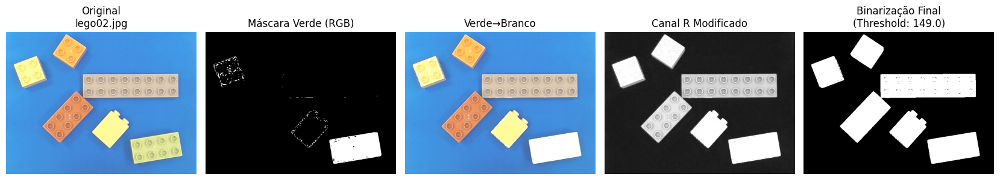

imagem: lego04.jpg


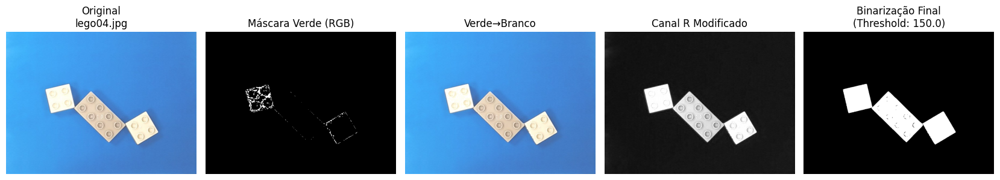

imagem: lego09.jpg


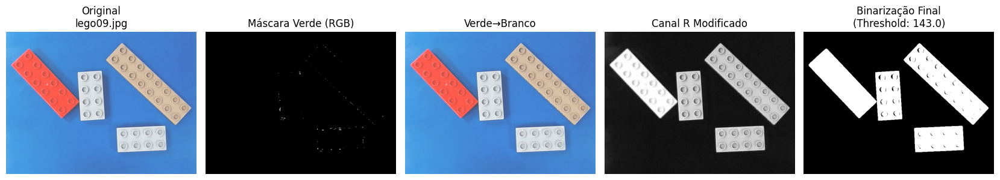

imagem: lego10.jpg


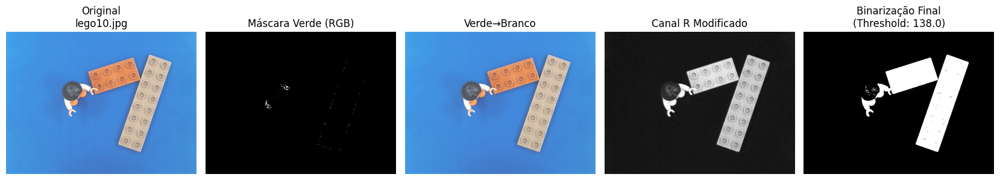

imagem: lego11.jpg


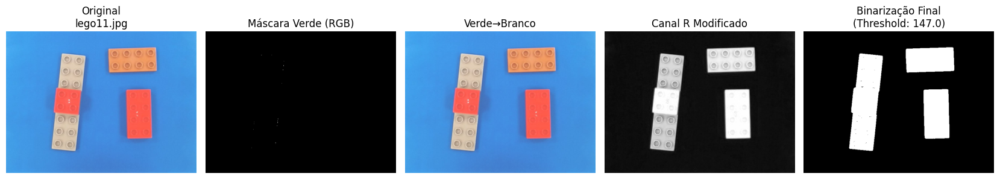

imagem: lego12.jpg


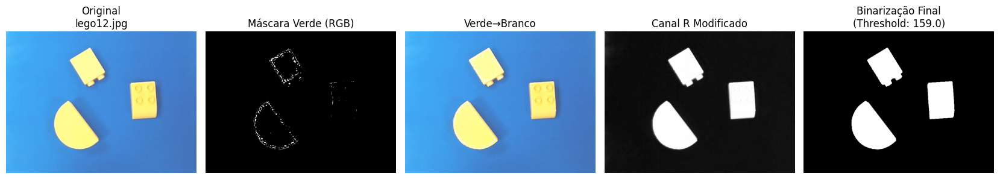

imagem: lego13.jpg


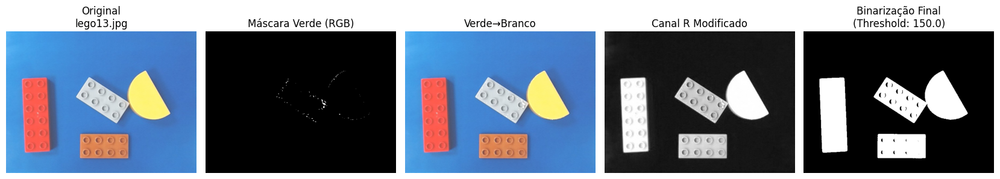

imagem: lego21.jpg


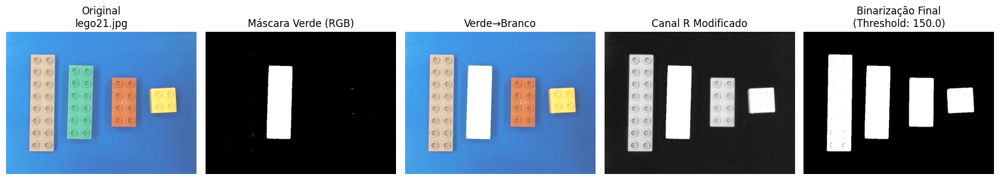

imagem: lego22.jpg


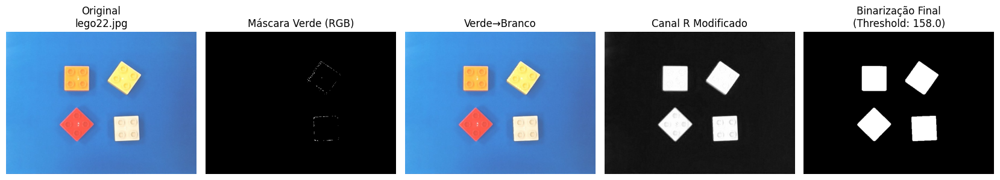

imagem: lego23.jpg


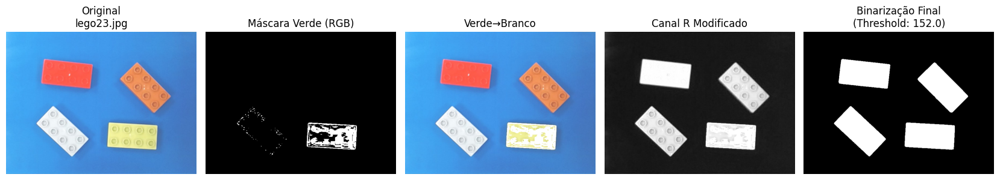

imagem: lego25.jpg


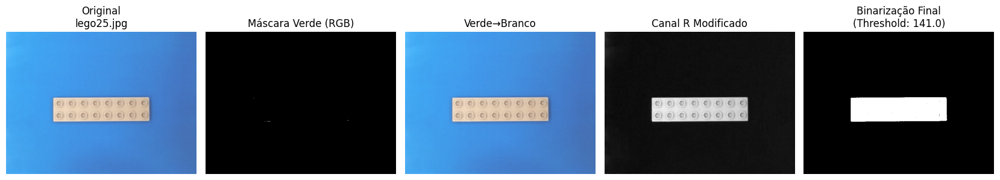

imagem: lego30.jpg


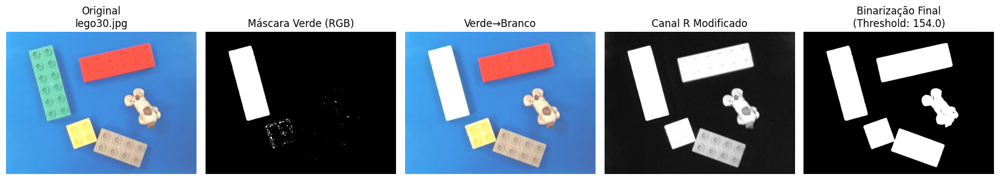

imagem: lego32.jpg


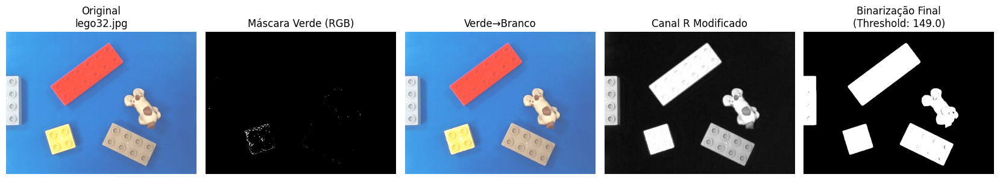

In [14]:
def binarizacao(img_name):
    """
    Função que converte peças verdes para branco e binariza usando canal vermelho.
    """
    img = leitura_imagem(img_name)
    
    # Converter peças verdes para branco usando apenas RGB
    img_modified, mask_green = converter_verde_para_branco(img)
    
    # Separar os canais da imagem modificada
    b, g, r = separar_canais(img_modified)
    
    # Binarizar o canal vermelho da imagem modificada
    threshold_value, binary = cv.threshold(r, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)
    
    plt.figure(figsize=(20, 3))
    
    plt.subplot(1, 6, 1)
    plt.imshow(img[..., ::-1])
    plt.title(f'Original\n{img_name}')
    plt.axis('off')
    
    plt.subplot(1, 6, 2)
    plt.imshow(mask_green, cmap='gray')
    plt.title('Máscara Verde (RGB)')
    plt.axis('off')
    
    plt.subplot(1, 6, 3)
    plt.imshow(img_modified[..., ::-1])
    plt.title('Verde→Branco')
    plt.axis('off')
    
    plt.subplot(1, 6, 4)
    plt.imshow(r, cmap='gray')
    plt.title('Canal R Modificado')
    plt.axis('off')
    
    plt.subplot(1, 6, 5)
    plt.imshow(binary, cmap='gray')
    plt.title(f'Binarização Final\n(Threshold: {threshold_value:.1f})')
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    return img_modified, binary

binaries = {}
for img_name in image_files:
    print(f"imagem: {img_name}")
    img, binary = binarizacao(img_name)
    binaries[img_name] = binary

### Justificação do código

Procedeu-se à **binarização**, onde, após ler a imagem e separar os seus canais de cor, se utilizou o **método de Otsu** no canal de cor vermelho da imagem já modificada (com as peças verdes convertidas para branco).

Este processo garante que todas as peças LEGO sejam corretamente identificadas como objetos na imagem binária final. A aplicação do **método de Otsu**, como já foi mencionado anteriormente, determina automaticamente o valor de threshold ideal para separar o fundo (píxeis pretos) dos objetos (píxeis brancos).

O resultado é uma imagem binária otimizada onde as peças aparecem como regiões brancas sobre um fundo preto homogéneo, que oferece as condições necessárias para as etapas seguintes.

## **2. Operações Morfológicas**

As **operações morfológicas** são técnicas fundamentais do **processamento digital de imagem**, utilizadas para **analisar e modificar a forma e a estrutura dos objetos** presentes numa imagem binária (embora também possam ser aplicadas em imagens em tons de cinzento).

Estas operações baseiam-se em **conceitos da morfologia matemática**, uma área da matemática que estuda as relações espaciais e estruturais entre os elementos de uma imagem — como **tamanho, forma, contorno e conectividade**.

Qualquer das operações utiliza um **elemento estruturante**, sendo este um **conjunto de coordenadas** que descreve a forma e o tamanho da vizinhança usada para examinar ou modificar a imagem.

imagem: lego01.jpg


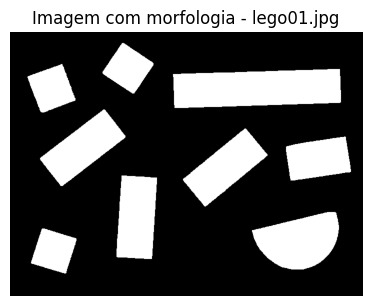

imagem: lego02.jpg


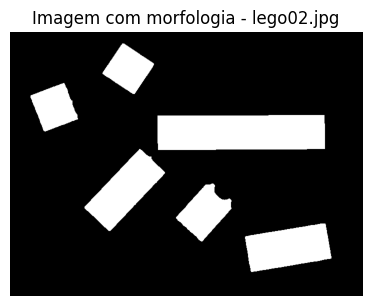

imagem: lego04.jpg


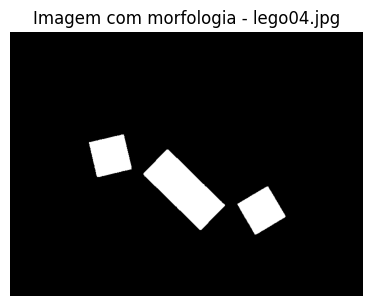

imagem: lego09.jpg


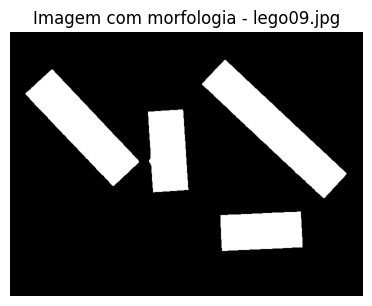

imagem: lego10.jpg


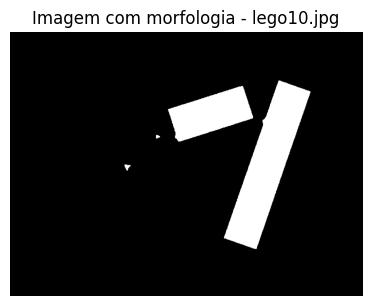

imagem: lego11.jpg


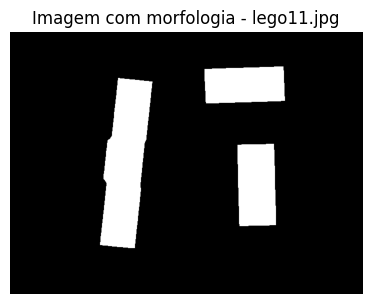

imagem: lego12.jpg


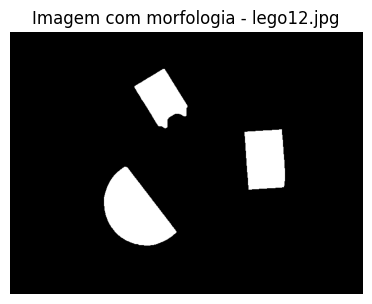

imagem: lego13.jpg


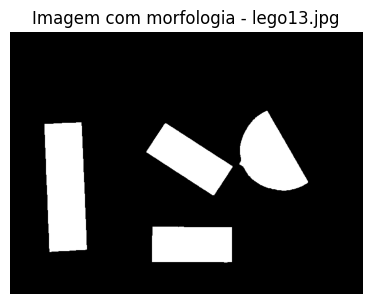

imagem: lego21.jpg


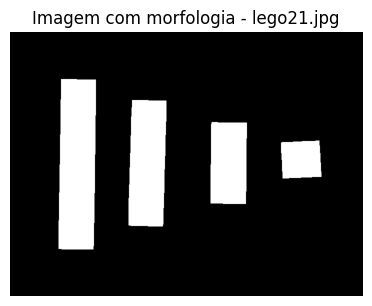

imagem: lego22.jpg


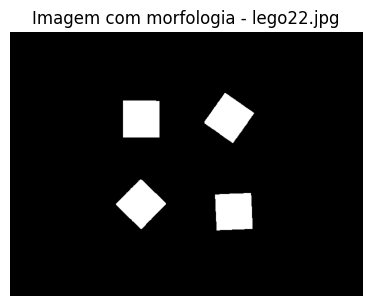

imagem: lego23.jpg


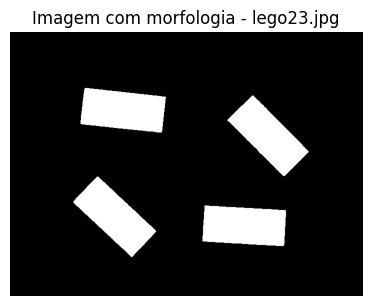

imagem: lego25.jpg


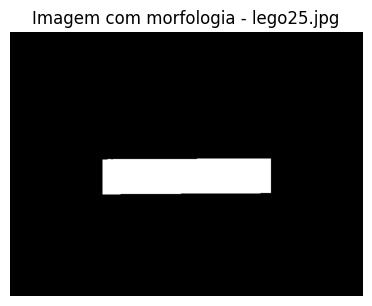

imagem: lego30.jpg


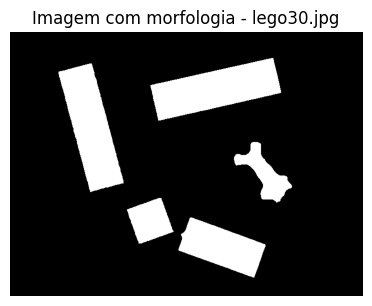

imagem: lego32.jpg


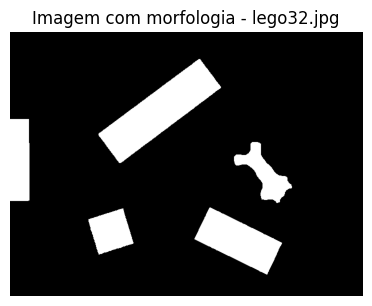

In [15]:
def operadores_morfologicos(binary, img_name):
    """
    Função que aplica operadores morfológicos à imagem binarizada.
    
    Parâmetros:
        binary: Imagem binarizada
        img_name: Nome do ficheiro de imagem
        
    Retorna:
        morph: Imagem após aplicação dos operadores morfológicos
    """

    kernel_small = cv.getStructuringElement(cv.MORPH_RECT, (3, 3))
    kernel_close = cv.getStructuringElement(cv.MORPH_ELLIPSE, (7, 7))
    kernel_separate = cv.getStructuringElement(cv.MORPH_ELLIPSE, (22, 22))

    morph = cv.morphologyEx(binary, cv.MORPH_OPEN, kernel_small)
    morph = cv.morphologyEx(morph, cv.MORPH_CLOSE, kernel_close)
    morph = cv.erode(morph, kernel_separate)
    morph = cv.dilate(morph, kernel_small)

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(morph, cmap='gray')
    plt.title(f'Imagem com morfologia - {img_name}')
    plt.axis('off')
    plt.show()
    
    return morph

morphs = {}
for img_name in image_files:
    print(f"imagem: {img_name}")
    morph = operadores_morfologicos(binaries[img_name], img_name)
    morphs[img_name] = morph

### Justificação do código

De modo a melhorar a imagem, foram aplicaram-se operações à imagem binária. Os operadores aplicados foram o `erode`, o `dilate` e o `morphologyEx`.

Estas operações foram aplicadas numa sequência específica para se poder separar bem as peças sem perder muito as suas definições:
1. Abertura | `cv.morphologyEx com MORPH_OPEN`: Remove ruído pequeno e separa objetos ligeiramente conectados, utilizando um kernel pequeno de 3x3 píxeis para preservar os detalhes das peças menores

2. Fecho | `cv.morphologyEx com MORPH_CLOSE`: Preenche lacunas internas e suaviza contornos usando um kernel elíptico de 7x7 píxeis, especialmente adequado para fechar os espaços deixados pelos **studs** (pinos) das peças LEGO

3. Erosão | `cv.erode`: Aplica uma erosão mais forte com um kernel elíptico grande (22x22 píxeis) para separar eficazmente peças que estejam em contacto, garantindo que cada peça seja identificada individualmente

4. Dilatação | `cv.dilate`: Recupera o tamanho aproximado das peças após a erosão, usando novamente o kernel pequeno de 3x3 píxeis para restaurar as dimensões originais sem voltar a conectar peças previamente separadas

## **3. Extração de componentes conexos**

A **extração de componentes conexos** é uma técnica fundamental no processamento de imagens que permite **identificar e isolar objetos distintos** numa imagem binária. Um **componente conexo** é definido como um conjunto de píxeis brancos (valor 255) que estão **conectados entre si**, seja por **conectividade de 4 vizinhos** (horizontal e vertical) ou **conectividade de 8 vizinhos** (incluindo diagonais).

imagem: lego01.jpg


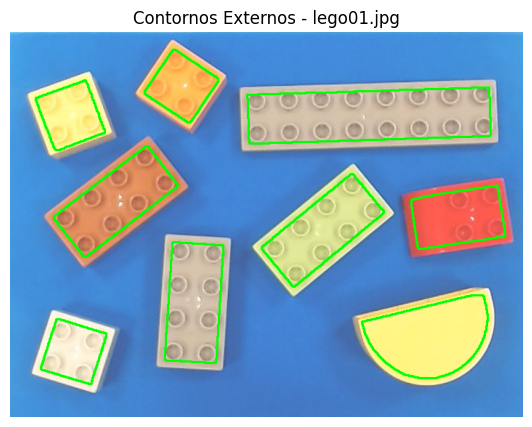

Número total de contornos em lego01.jpg: 9
Número de contornos desenhados em lego01.jpg: 9
imagem: lego02.jpg


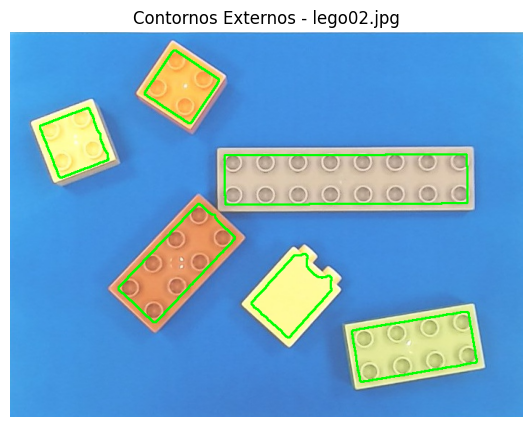

Número total de contornos em lego02.jpg: 6
Número de contornos desenhados em lego02.jpg: 6
imagem: lego04.jpg


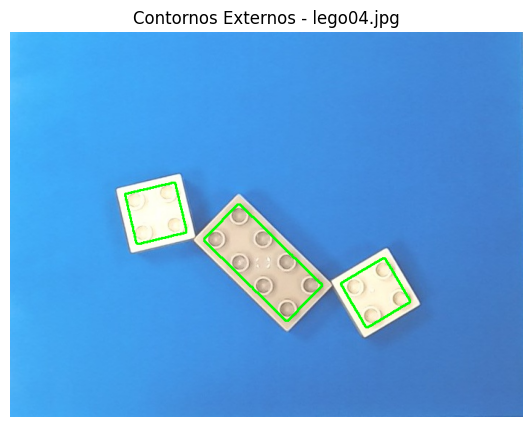

Número total de contornos em lego04.jpg: 3
Número de contornos desenhados em lego04.jpg: 3
imagem: lego09.jpg


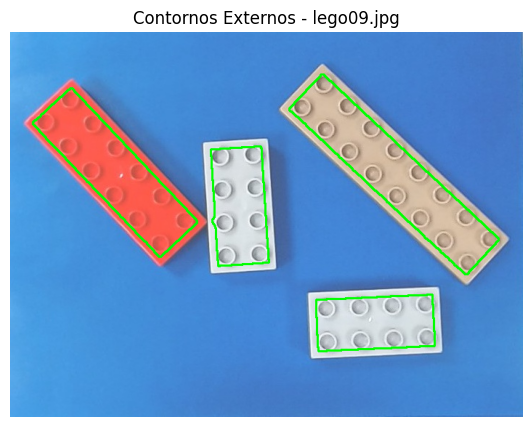

Número total de contornos em lego09.jpg: 4
Número de contornos desenhados em lego09.jpg: 4
imagem: lego10.jpg


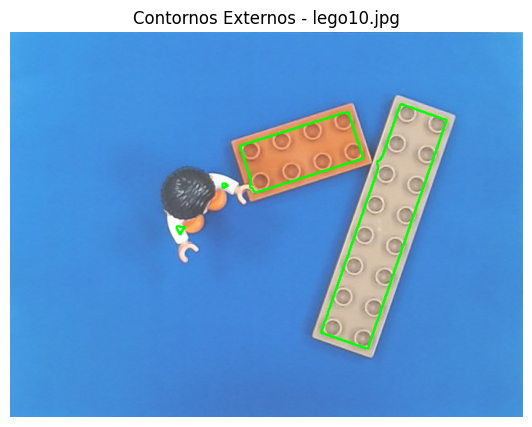

Número total de contornos em lego10.jpg: 4
Número de contornos desenhados em lego10.jpg: 4
imagem: lego11.jpg


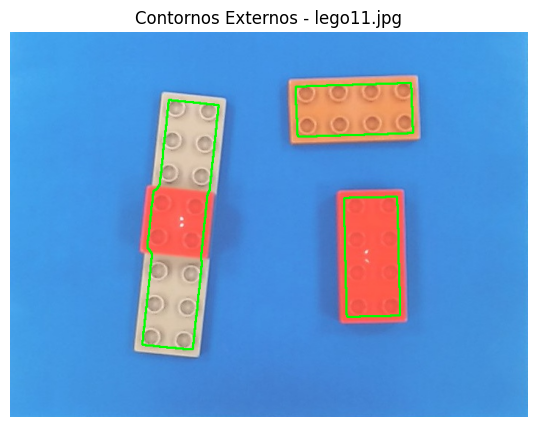

Número total de contornos em lego11.jpg: 3
Número de contornos desenhados em lego11.jpg: 3
imagem: lego12.jpg


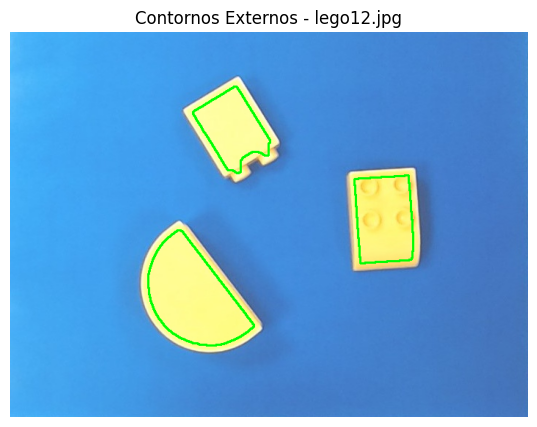

Número total de contornos em lego12.jpg: 3
Número de contornos desenhados em lego12.jpg: 3
imagem: lego13.jpg


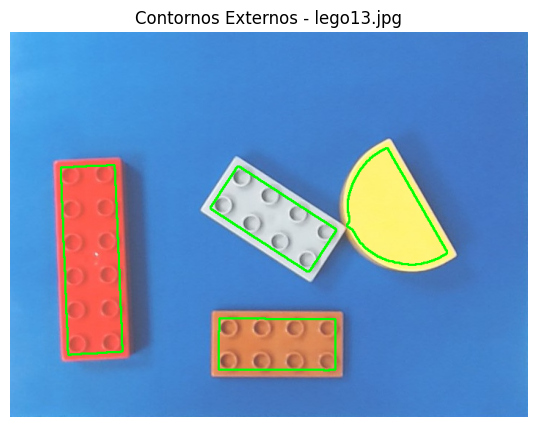

Número total de contornos em lego13.jpg: 4
Número de contornos desenhados em lego13.jpg: 4
imagem: lego21.jpg


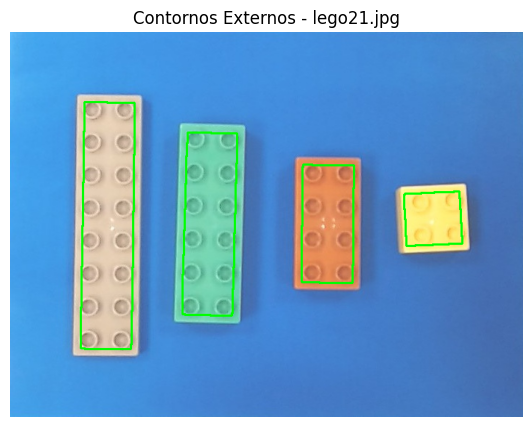

Número total de contornos em lego21.jpg: 4
Número de contornos desenhados em lego21.jpg: 4
imagem: lego22.jpg


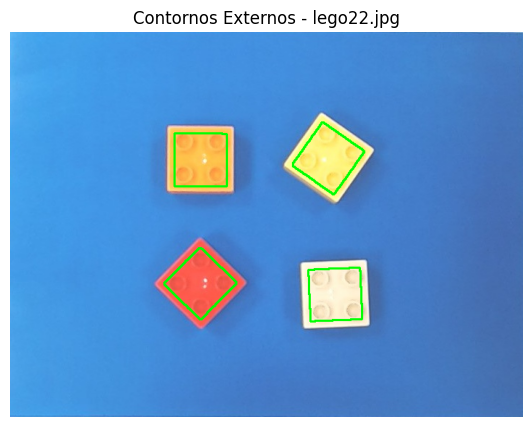

Número total de contornos em lego22.jpg: 4
Número de contornos desenhados em lego22.jpg: 4
imagem: lego23.jpg


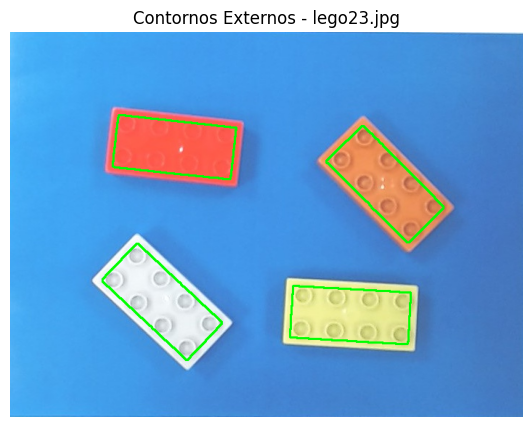

Número total de contornos em lego23.jpg: 4
Número de contornos desenhados em lego23.jpg: 4
imagem: lego25.jpg


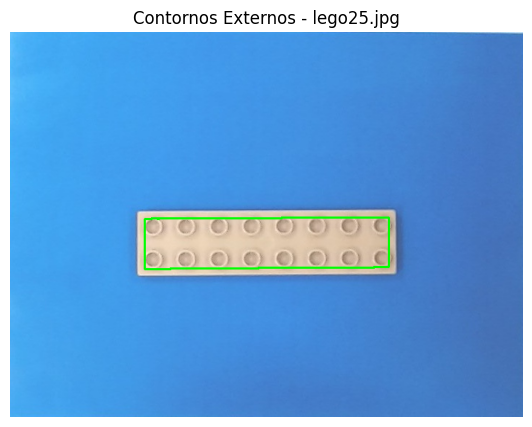

Número total de contornos em lego25.jpg: 1
Número de contornos desenhados em lego25.jpg: 1
imagem: lego30.jpg


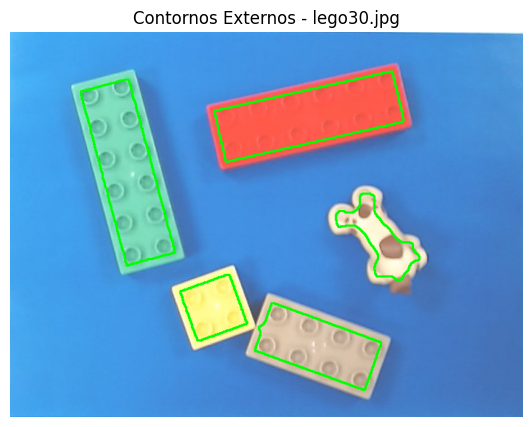

Número total de contornos em lego30.jpg: 5
Número de contornos desenhados em lego30.jpg: 5
imagem: lego32.jpg


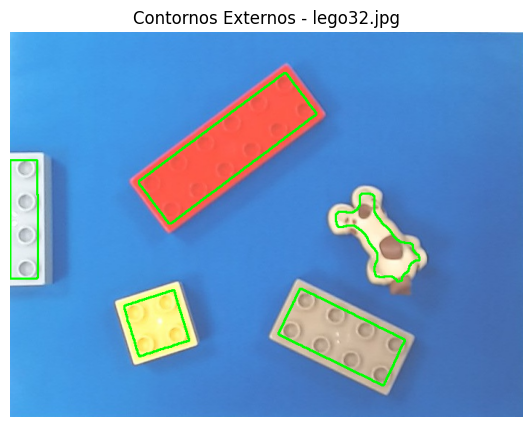

Número total de contornos em lego32.jpg: 5
Número de contornos desenhados em lego32.jpg: 5


In [16]:
def contours(img, morph, img_name):
    """
    Função que encontra e desenha contornos na imagem.
    
    Parâmetros:
        img: Imagem original
        morph: Imagem após operadores morfológicos
        img_name: Nome do ficheiro de imagem
        
    Retorna:
        contours: Lista de contornos encontrados
        img_result: Imagem com contornos desenhados
    """
    # encontrar contornos
    contours, _ = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
    img_result = img.copy()
    
    # desenhar contornos
    drawn_count = 0
    for contour in contours:
        cv.drawContours(img_result, [contour], -1, (0, 255, 0), 2)
        drawn_count += 1
    
    plt.figure(figsize=(10, 5))
    plt.imshow(img_result[..., ::-1])
    plt.title(f'Contornos Externos - {img_name}')
    plt.axis('off')
    plt.show()
    
    print(f"Número total de contornos em {img_name}: {len(contours)}")
    print(f"Número de contornos desenhados em {img_name}: {drawn_count}")
    
    return contours, img_result

contours_dict = {}
img_results_dict = {}

for img_name in image_files:
    print(f"imagem: {img_name}")
    # obter a imagem original correspondente
    img = leitura_imagem(img_name)
    # usar a imagem morfológica correta para esta imagem
    contours_list, img_result = contours(img, morphs[img_name], img_name)
    # guardar nos dicionários
    contours_dict[img_name] = contours_list
    img_results_dict[img_name] = img_result

### Justificação do código

Esta terceira função, a `contours`, foi criada de modo a encontrar e desenhar os contornos de cada peça na imagem com os operadores morfológicos aplicados.

A função utiliza a **`cv.findContours()`** para detectar automaticamente todos os componentes conexos presentes na imagem processada. Esta função é fundamental porque transforma a imagem binária em **estruturas de dados manipuláveis** (listas de pontos) que representam cada peça LEGO individualmente.

**`cv.RETR_EXTERNAL`**: Recupera apenas os contornos **externos** dos objetos e ignora possíveis contornos internos (buracos) das peças, reduzindo o número de contornos desnecessários

**`cv.CHAIN_APPROX_SIMPLE`**: Comprime a representação dos contornos, isto é, remove pontos redundantes ao longo de linhas retas. Por exemplo, uma linha reta com 100 pontos é representada apenas pelos pontos inicial e final

A função **`cv.drawContours()`** foi utilizada para sobrepor os contornos encontrados na **imagem original colorida**. A cor escolhida foi a verde, para fazer contraste com as peças, e a espessura foi de dois píxeis, que é suficiente para visualização clara sem cobrir detalhes importantes.

O print do **número total de contornos** serviu para *debug*, permitindo:
- Verificar se o número de contornos corresponde ao número esperado de peças
- Identificar rapidamente se há **excesso de ruído** (muitos contornos pequenos) ou **fusão indevida** de peças (poucos contornos)

## **4. Extração de propriedades**

A **extração de propriedades** é uma etapa fundamental no processamento de imagens que consiste em **quantificar características específicas dos objetos** identificados nos componentes conexos. Esta fase transforma informações visuais em **dados numéricos mensuráveis**, permitindo a análise matemática e a classificação automatizada dos elementos presentes na imagem.

In [17]:
def extracao_propriedades(img, contours, img_result, img_name):
    """
    Função que extrai propriedades dos contornos através da aproximação poligonal.
    
    Parâmetros:
        img: Imagem original
        contours: Lista de contornos encontrados
        img_result: Imagem com contornos desenhados
        img_name: Nome do ficheiro de imagem
        
    Retorna:
        approximated_contours: Lista de contornos aproximados poligonalmente
    """
    
    img_smooth_contours = img.copy()
    approximated_contours = []

    for i, contour in enumerate(contours):
        # aproximação poligonal (reduz o número de pontos)
        epsilon = 0.02 * cv.arcLength(contour, True)
        approx = cv.approxPolyDP(contour, epsilon, True)
        approximated_contours.append(approx)
        
        # desenhar o contorno aproximado
        cv.drawContours(img_smooth_contours, [approx], -1, (255, 0, 0), 2)

        # calcular o centróide do contorno para posicionar o texto
        M = cv.moments(approx)
        if M["m00"] != 0:
            cx = int(M["m10"] / M["m00"])
            cy = int(M["m01"] / M["m00"])
            
            # adicionar o número do índice no centro do contorno
            cv.putText(img_smooth_contours, str(i), (cx-10, cy+5), 
                        cv.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 2)

    # mostrar resultados para esta imagem
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(img_result[..., ::-1])
    plt.title(f'Contornos Originais - {img_name}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(img_smooth_contours[..., ::-1])
    plt.title(f'Contornos Aproximados (Poligonais) - {img_name}')
    plt.axis('off')
    plt.show()

    return approximated_contours

### Justificação do código

A função `extracao_propriedades` implementa a **aproximação poligonal** dos contornos através do algoritmo de **Douglas-Peucker**, de modo que a distância entre eles seja menor ou igual à precisão especificada, ou seja, uma curva, por exemplo, ficará mais poligonal, pois irá perder significativamente o seu número de vértices. representado pela função `cv.approxPolyDP()`. Foi usado este algoritmo devido a existirem peças que não são retângulares o quadrangulares, sendo necessário o programa identificá-las como 'outras'.

Para controlar a precisão da aproximação poligonal, criou-se, *a priori*, a variável `epsilon`. Esta consiste na multiplicação entre um valor `x` e o método `cv.arcLength`, que serve para calcular o perímetro de um contorno. O valor `x` escolhido foi 0.02, ou seja, 2%. Ao alterar este valor, percebeu-se que:
- Quanto menor o `epsilon`, mais precisa é a aproximação (mais vértices preservados)
- Quanto maior o `epsilon`, mais simplificada é a aproximação (menos vértices)

Antes de mostrar a imagem com os contornos aproximados, para fazer *debug*, utilizou-se o método `cv.moments` em cada contorno aproximado, para escrever o valor do índice `i` no centróide de cada peça de Lego.

imagem: lego01.jpg


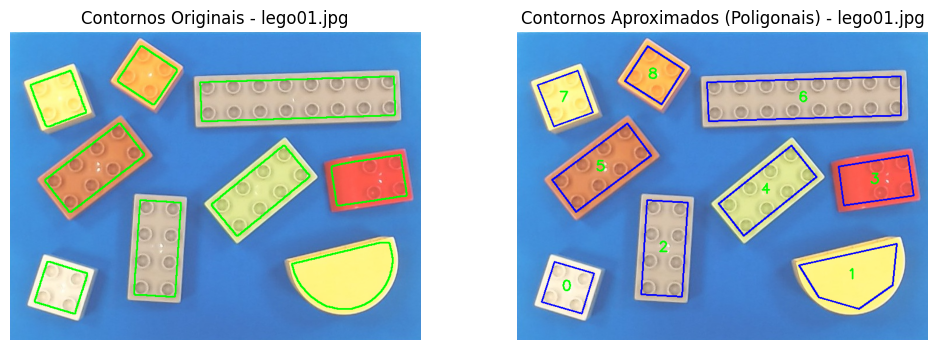


Análise de vértices e áreas - lego01.jpg:
Contorno 0 - Vértices: 4 | Área: 5156.50 píxeis
Contorno 1 - Vértices: 5 | Área: 11678.50 píxeis
Contorno 2 - Vértices: 4 | Área: 11380.00 píxeis
Contorno 3 - Vértices: 4 | Área: 8297.00 píxeis
Contorno 4 - Vértices: 4 | Área: 11134.00 píxeis
Contorno 5 - Vértices: 4 | Área: 11072.00 píxeis
Contorno 6 - Vértices: 4 | Área: 22225.50 píxeis
Contorno 7 - Vértices: 4 | Área: 5523.50 píxeis
Contorno 8 - Vértices: 4 | Área: 5290.00 píxeis
imagem: lego02.jpg


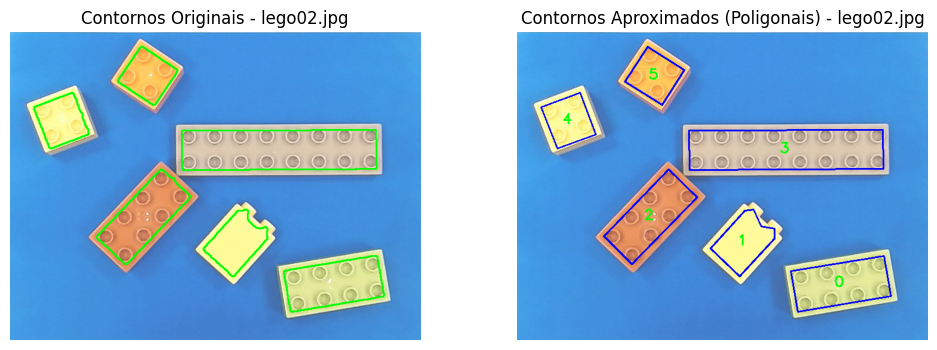


Análise de vértices e áreas - lego02.jpg:
Contorno 0 - Vértices: 4 | Área: 11438.00 píxeis
Contorno 1 - Vértices: 7 | Área: 6548.00 píxeis
Contorno 2 - Vértices: 4 | Área: 10929.50 píxeis
Contorno 3 - Vértices: 4 | Área: 22479.00 píxeis
Contorno 4 - Vértices: 4 | Área: 5428.50 píxeis
Contorno 5 - Vértices: 4 | Área: 5350.00 píxeis
imagem: lego04.jpg


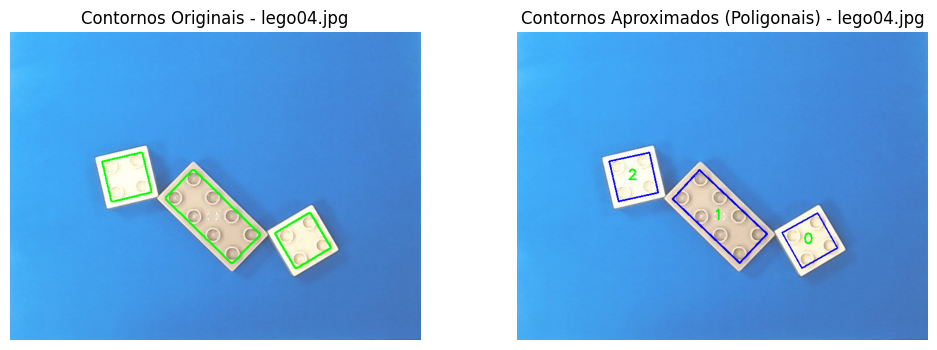


Análise de vértices e áreas - lego04.jpg:
Contorno 0 - Vértices: 4 | Área: 4863.50 píxeis
Contorno 1 - Vértices: 4 | Área: 10890.00 píxeis
Contorno 2 - Vértices: 4 | Área: 4959.00 píxeis
imagem: lego09.jpg


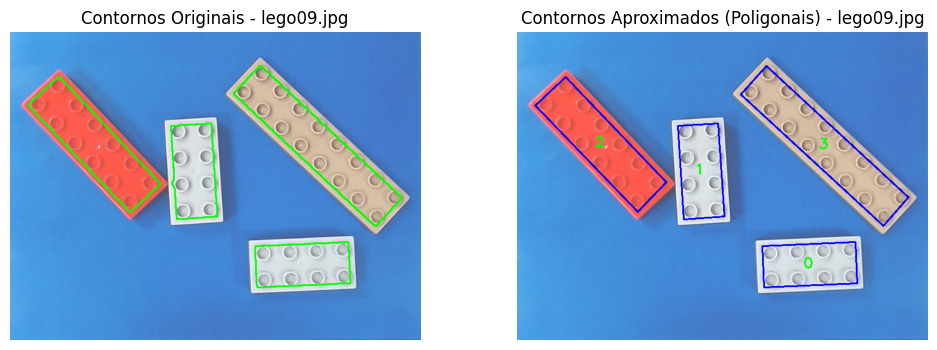


Análise de vértices e áreas - lego09.jpg:
Contorno 0 - Vértices: 4 | Área: 11381.00 píxeis
Contorno 1 - Vértices: 4 | Área: 11202.00 píxeis
Contorno 2 - Vértices: 4 | Área: 17916.00 píxeis
Contorno 3 - Vértices: 4 | Área: 21811.50 píxeis
imagem: lego10.jpg


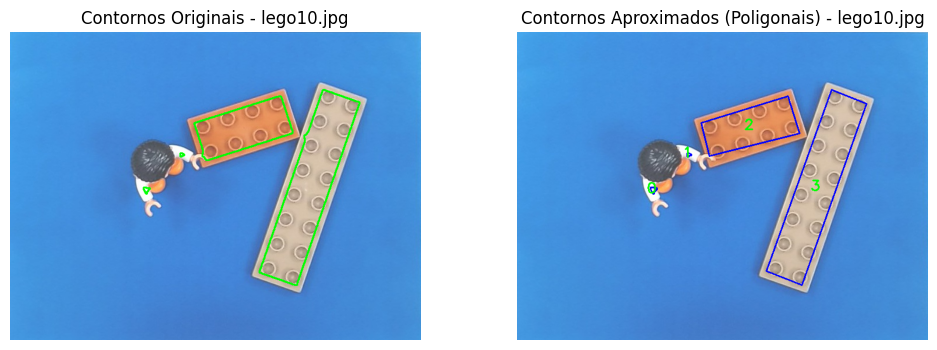


Análise de vértices e áreas - lego10.jpg:
Contorno 0 - Vértices: 7 | Área: 72.00 píxeis
Contorno 1 - Vértices: 7 | Área: 31.00 píxeis
Contorno 2 - Vértices: 4 | Área: 9918.50 píxeis
Contorno 3 - Vértices: 4 | Área: 21552.00 píxeis
imagem: lego11.jpg


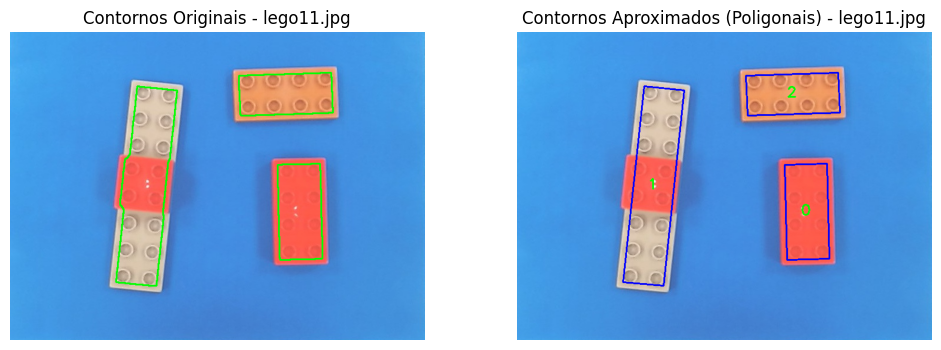


Análise de vértices e áreas - lego11.jpg:
Contorno 0 - Vértices: 4 | Área: 11672.00 píxeis
Contorno 1 - Vértices: 4 | Área: 23075.50 píxeis
Contorno 2 - Vértices: 4 | Área: 10691.00 píxeis
imagem: lego12.jpg


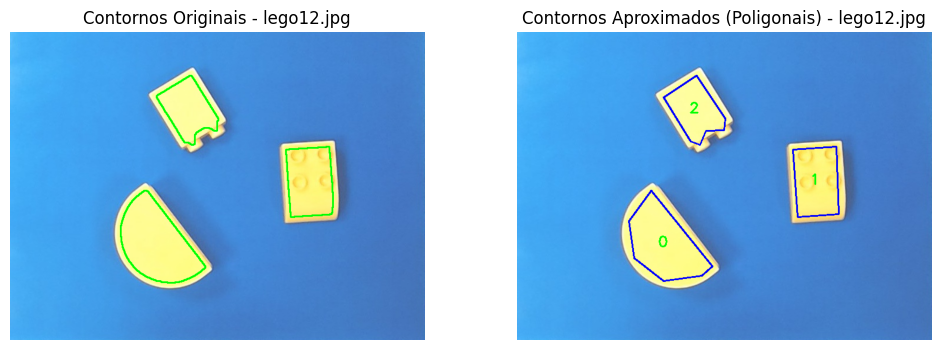


Análise de vértices e áreas - lego12.jpg:
Contorno 0 - Vértices: 6 | Área: 11964.00 píxeis
Contorno 1 - Vértices: 4 | Área: 8310.00 píxeis
Contorno 2 - Vértices: 7 | Área: 6567.00 píxeis
imagem: lego13.jpg


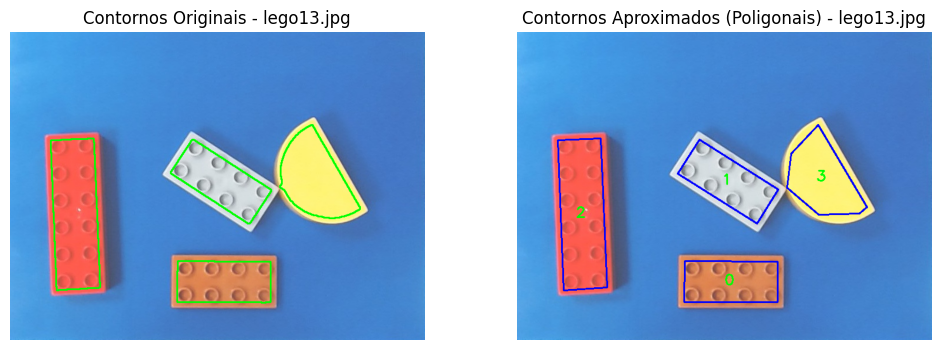


Análise de vértices e áreas - lego13.jpg:
Contorno 0 - Vértices: 4 | Área: 11016.00 píxeis
Contorno 1 - Vértices: 4 | Área: 10903.50 píxeis
Contorno 2 - Vértices: 4 | Área: 18784.50 píxeis
Contorno 3 - Vértices: 6 | Área: 11916.50 píxeis
imagem: lego21.jpg


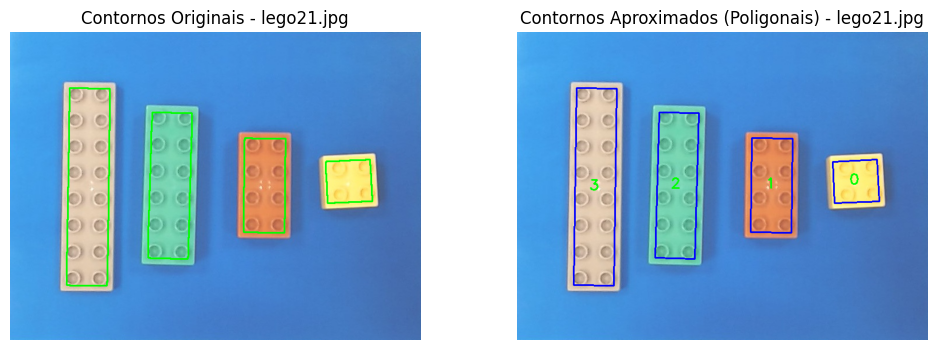


Análise de vértices e áreas - lego21.jpg:
Contorno 0 - Vértices: 4 | Área: 5482.00 píxeis
Contorno 1 - Vértices: 4 | Área: 11342.00 píxeis
Contorno 2 - Vértices: 4 | Área: 17044.50 píxeis
Contorno 3 - Vértices: 4 | Área: 23396.00 píxeis
imagem: lego22.jpg


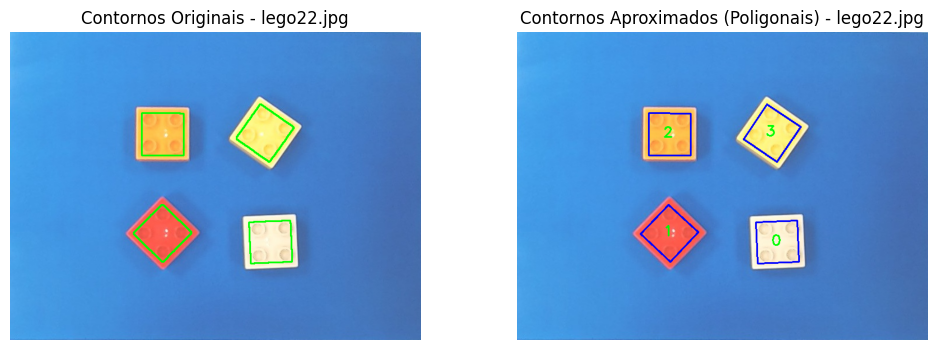


Análise de vértices e áreas - lego22.jpg:
Contorno 0 - Vértices: 4 | Área: 5050.00 píxeis
Contorno 1 - Vértices: 4 | Área: 4855.50 píxeis
Contorno 2 - Vértices: 4 | Área: 5220.00 píxeis
Contorno 3 - Vértices: 4 | Área: 5029.50 píxeis
imagem: lego23.jpg


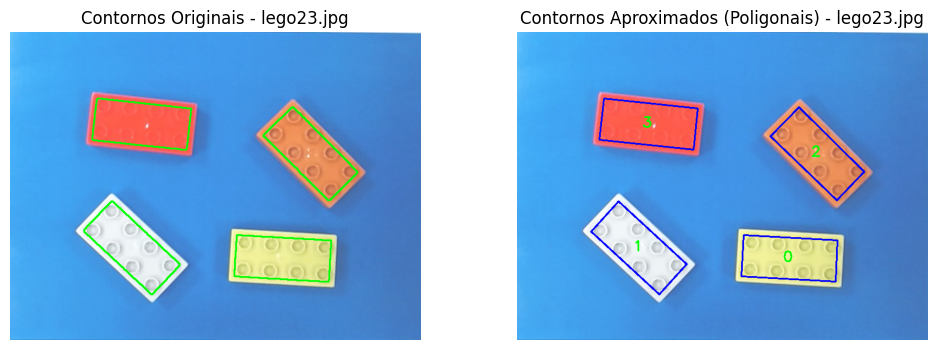


Análise de vértices e áreas - lego23.jpg:
Contorno 0 - Vértices: 4 | Área: 11498.00 píxeis
Contorno 1 - Vértices: 4 | Área: 11160.00 píxeis
Contorno 2 - Vértices: 4 | Área: 10897.50 píxeis
Contorno 3 - Vértices: 4 | Área: 11594.00 píxeis
imagem: lego25.jpg


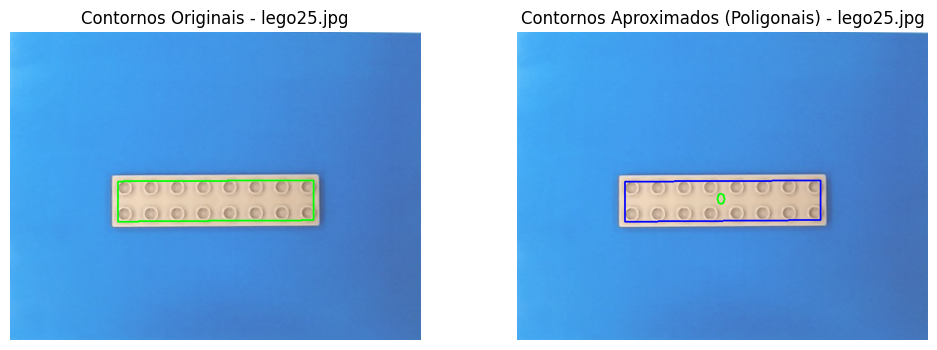


Análise de vértices e áreas - lego25.jpg:
Contorno 0 - Vértices: 4 | Área: 23016.00 píxeis
imagem: lego30.jpg


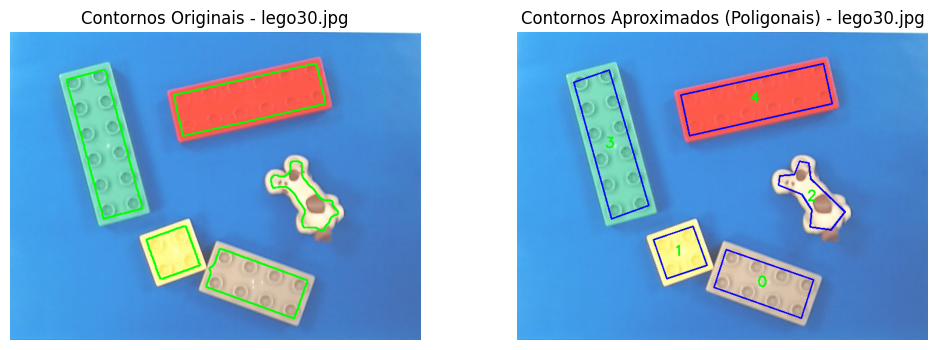


Análise de vértices e áreas - lego30.jpg:
Contorno 0 - Vértices: 4 | Área: 10927.50 píxeis
Contorno 1 - Vértices: 4 | Área: 5130.00 píxeis
Contorno 2 - Vértices: 11 | Área: 5186.50 píxeis
Contorno 3 - Vértices: 4 | Área: 16088.00 píxeis
Contorno 4 - Vértices: 4 | Área: 17845.00 píxeis
imagem: lego32.jpg


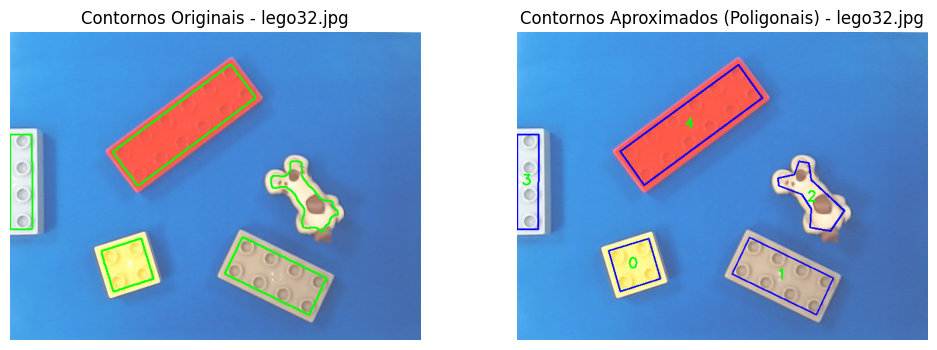


Análise de vértices e áreas - lego32.jpg:
Contorno 0 - Vértices: 4 | Área: 5225.50 píxeis
Contorno 1 - Vértices: 4 | Área: 11168.50 píxeis
Contorno 2 - Vértices: 11 | Área: 5236.50 píxeis
Contorno 3 - Vértices: 4 | Área: 5949.50 píxeis
Contorno 4 - Vértices: 4 | Área: 17802.00 píxeis


In [18]:
def analise_vertices_areas(approximated_contours, img_name):
    """
    Função que analisa o número de vértices e calcula as áreas dos contornos aproximados.
    
    Parâmetros:
        approximated_contours: Lista de contornos aproximados poligonalmente
        img_name: Nome do ficheiro de imagem
        
    Retorna:
        areas_peças: Lista com as áreas de cada peça/contorno
    """

    print(f"\nAnálise de vértices e áreas - {img_name}:")
    
    # análise de vértices - len(approx_contour) conta o número de contornos, que por sua vez é igual ao número de vértices
    # análise de áreas
    areas_peças = []
    for i, approx_contour in enumerate(approximated_contours):
        num_vertices = len(approx_contour)
        area = cv.contourArea(approx_contour)
        areas_peças.append(area)
        print(f"Contorno {i} - Vértices: {num_vertices} | Área: {area:.2f} píxeis")
    
    return areas_peças

approximated_contours_dict = {}
areas_pecas_dict = {}

for img_name in image_files:
    print(f"imagem: {img_name}")
    # Obter a imagem original correspondente
    img = leitura_imagem(img_name)
    # Usar os contornos e img_result corretos para esta imagem
    approximated_contours = extracao_propriedades(img, contours_dict[img_name], img_results_dict[img_name], img_name)
    # Calcular as áreas para esta imagem
    areas_peças = analise_vertices_areas(approximated_contours, img_name)
    
    # Guardar nos dicionários
    approximated_contours_dict[img_name] = approximated_contours
    areas_pecas_dict[img_name] = areas_peças

### Justificação do código

A função `analise_vertices_areas` foi implementada para fazer *debug*, de modo a se perceber o número de vértices e o valor das áreas de cada peça, depois de se fazer a aproximação poligonal.

O cálculo das áreas foi feito utilizando o método `cv.contourArea` em cada um dos contornos aproximados. No final, cada valor de área foi guardado numa lista.

## **5. Classificação de objetos**

A classificação de objetos consiste em categorizar automaticamente os objetos identificados com base nas suas características extraídas. No contexto do trabalho, após a identificação e extração das propriedades das peças LEGO, o objetivo é classificá-las por dimensão (2x2, 2x4, 2x6, 2x8, ou "outras").

In [19]:
def verifica_peca_na_borda(contour, img_width, img_height, border_threshold=10):
    """
    Função que verifica se uma peça está a ser cortada pela borda da imagem.
    
    Parâmetros:
        contour: Contorno da peça
        img_width: Largura da imagem
        img_height: Altura da imagem
        border_threshold: Distância mínima da borda para considerar que a peça não está cortada
        
    Retorna:
        bool: True se a peça estiver na borda, False caso contrário
    """
    # obter o retângulo delimitador do contorno
    x, y, w, h = cv.boundingRect(contour)
    
    # verificar se a peça toca alguma das bordas
    touches_left = x <= border_threshold
    touches_right = x + w >= img_width - border_threshold
    touches_top = y <= border_threshold
    touches_bottom = y + h >= img_height - border_threshold
    
    # retorna True se tocar qualquer borda
    return touches_left or touches_right or touches_top or touches_bottom

imagem: lego01.jpg


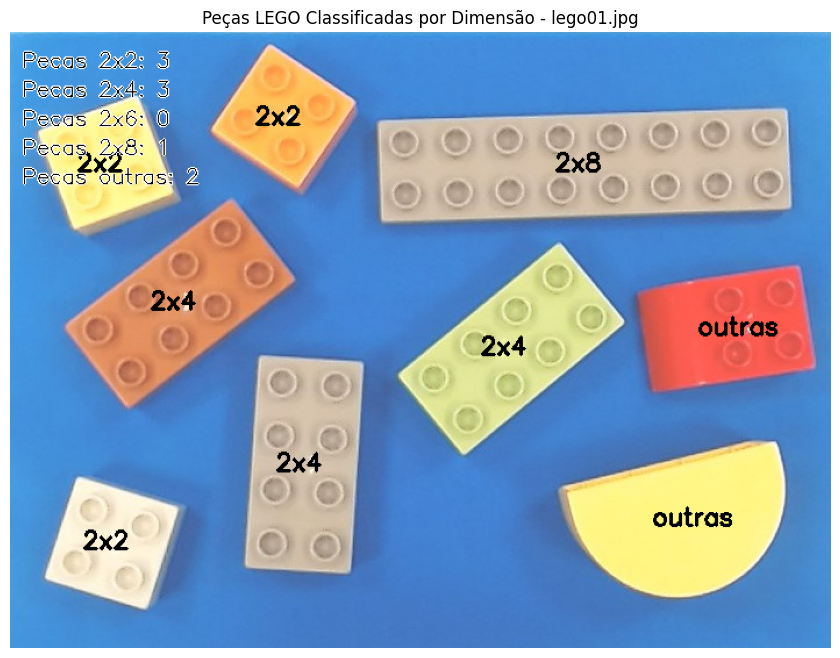

imagem: lego02.jpg


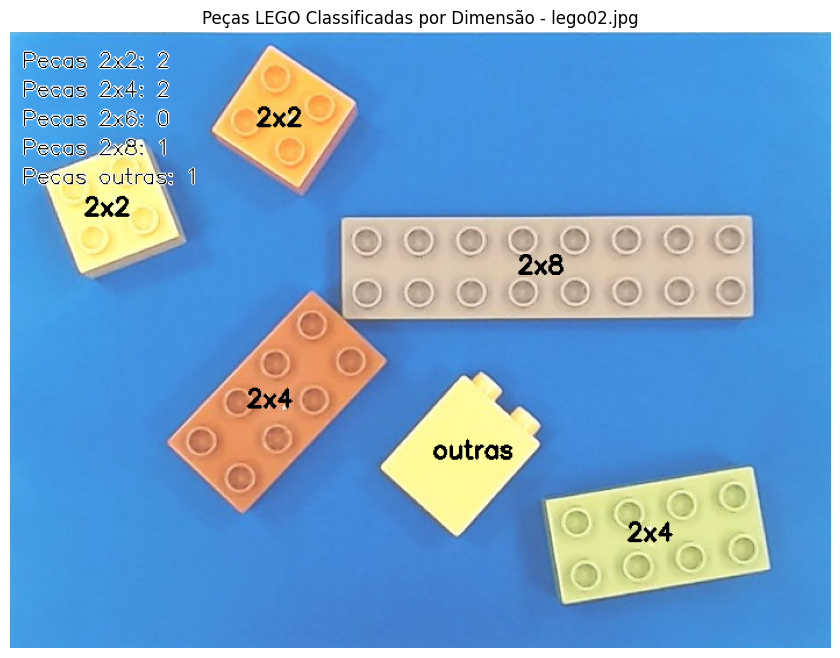

imagem: lego04.jpg


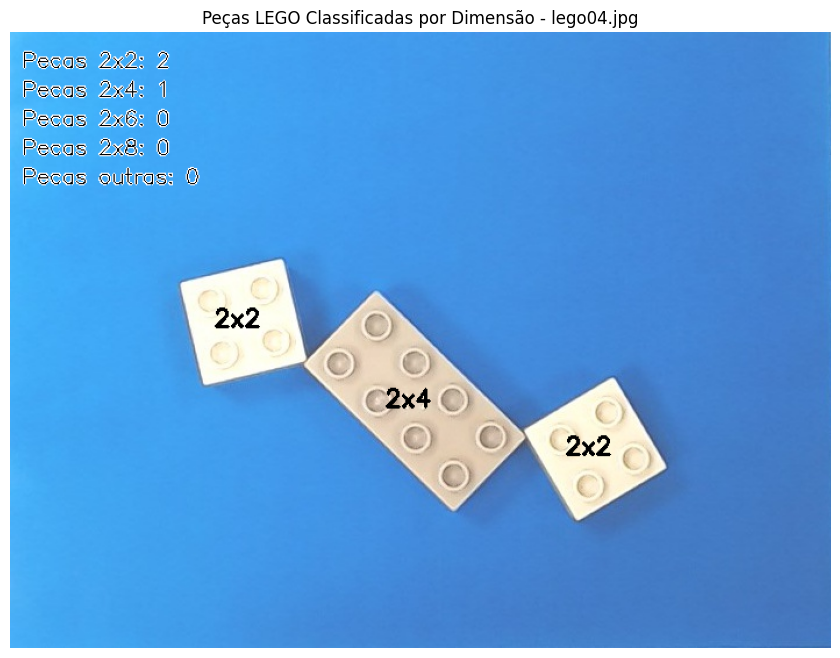

imagem: lego09.jpg


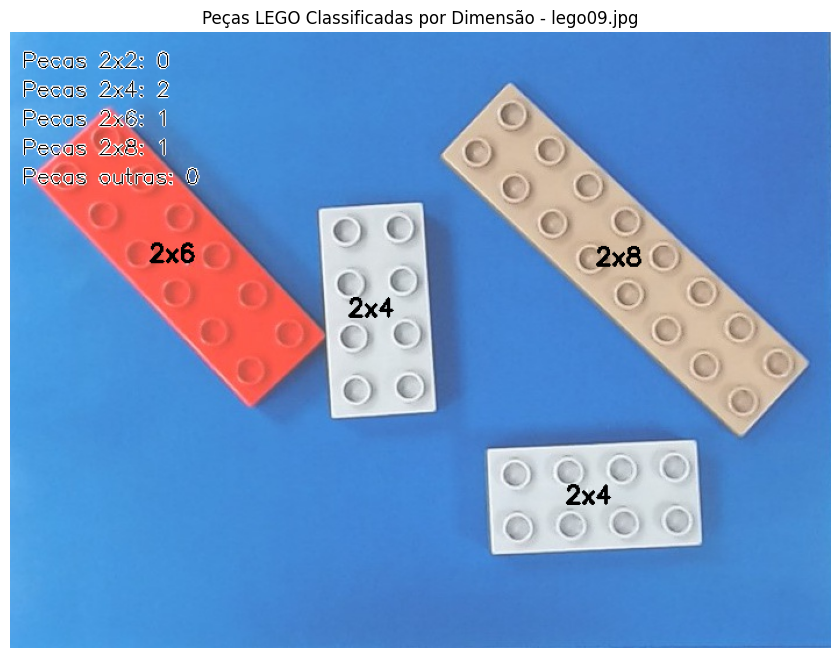

imagem: lego10.jpg


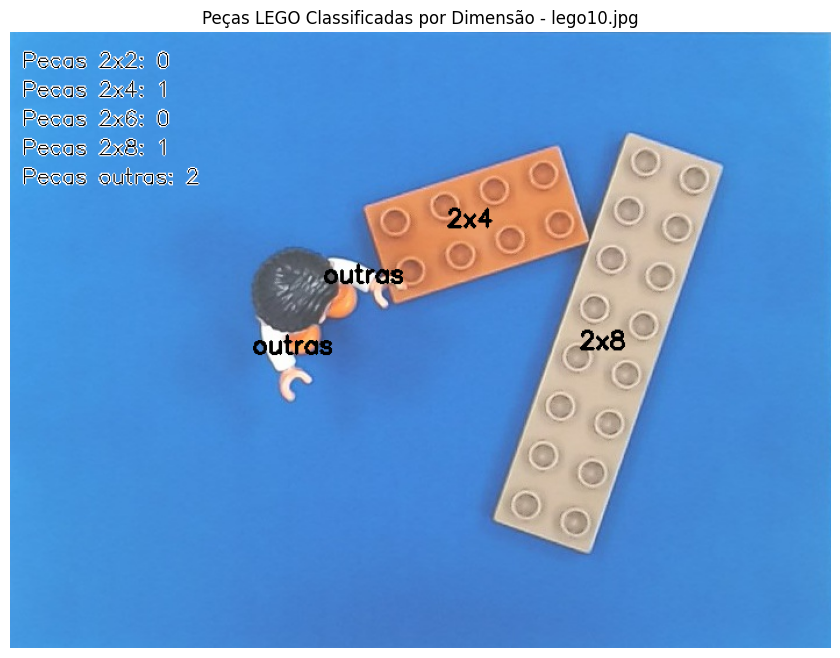

imagem: lego11.jpg


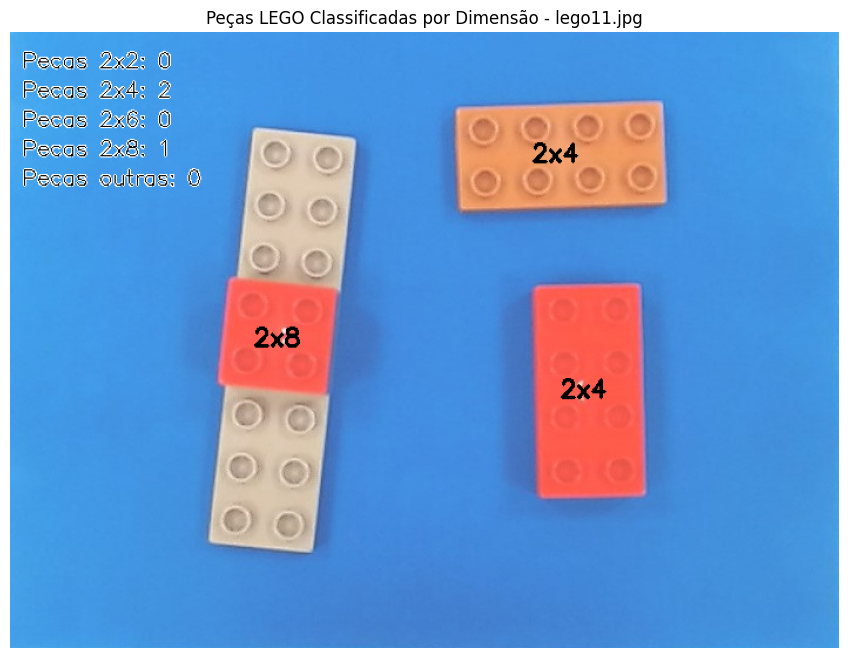

imagem: lego12.jpg


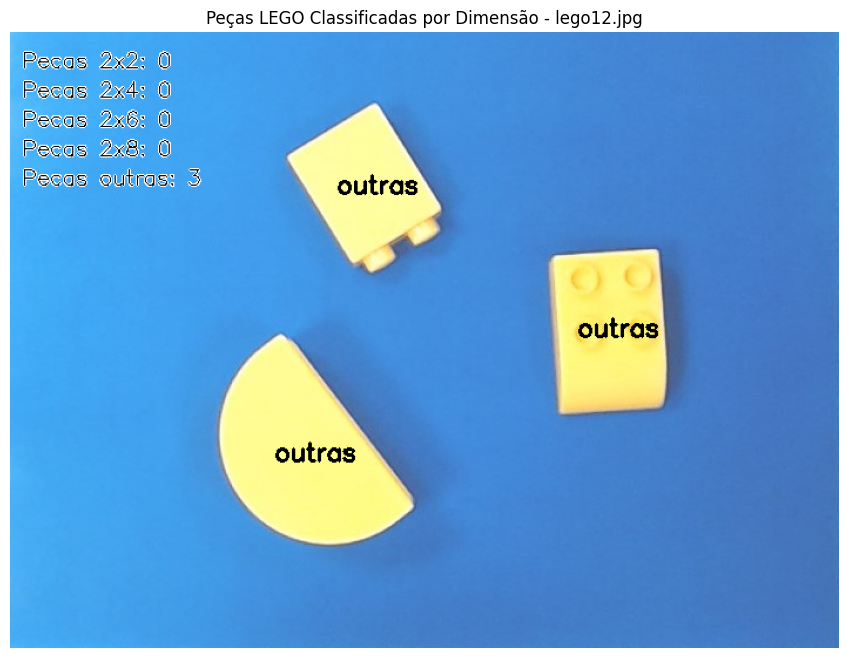

imagem: lego13.jpg


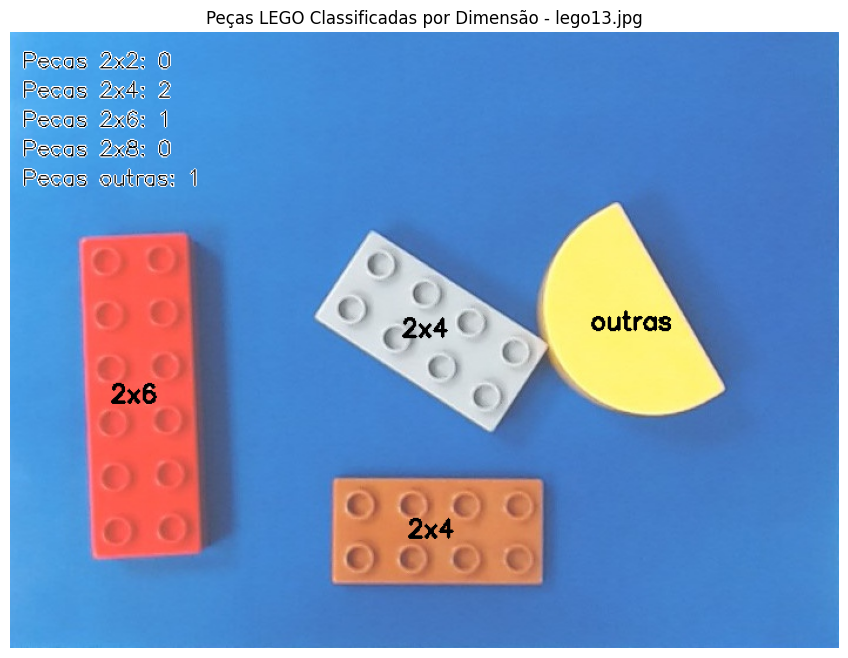

imagem: lego21.jpg


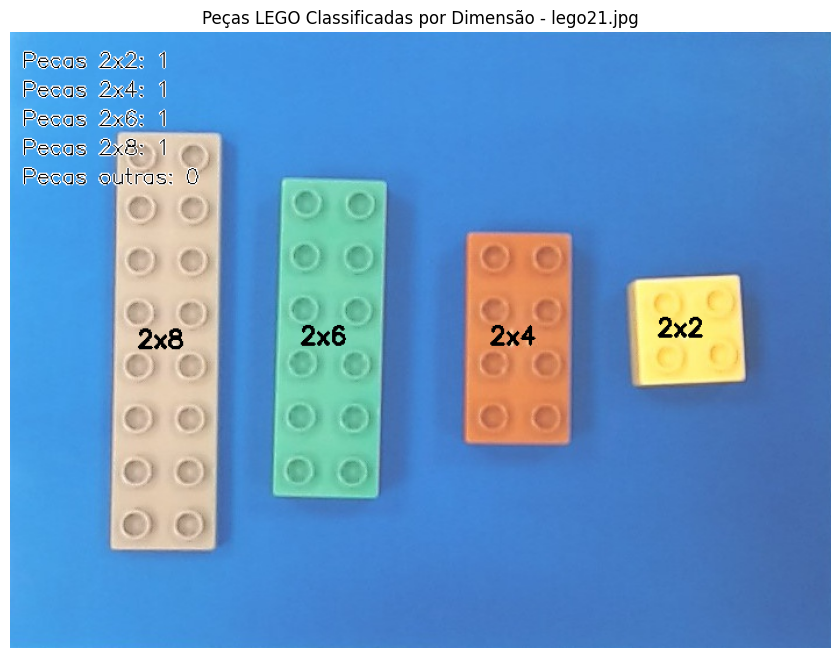

imagem: lego22.jpg


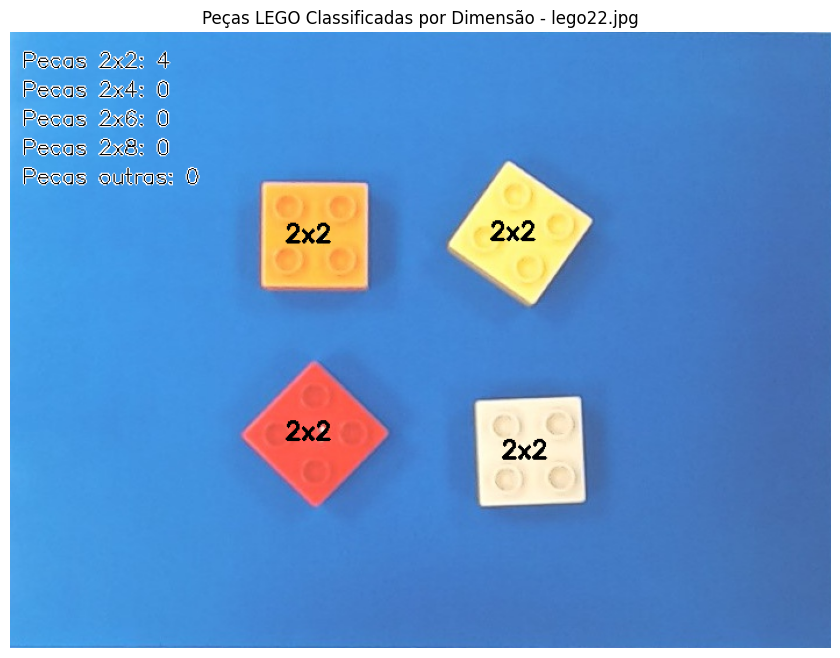

imagem: lego23.jpg


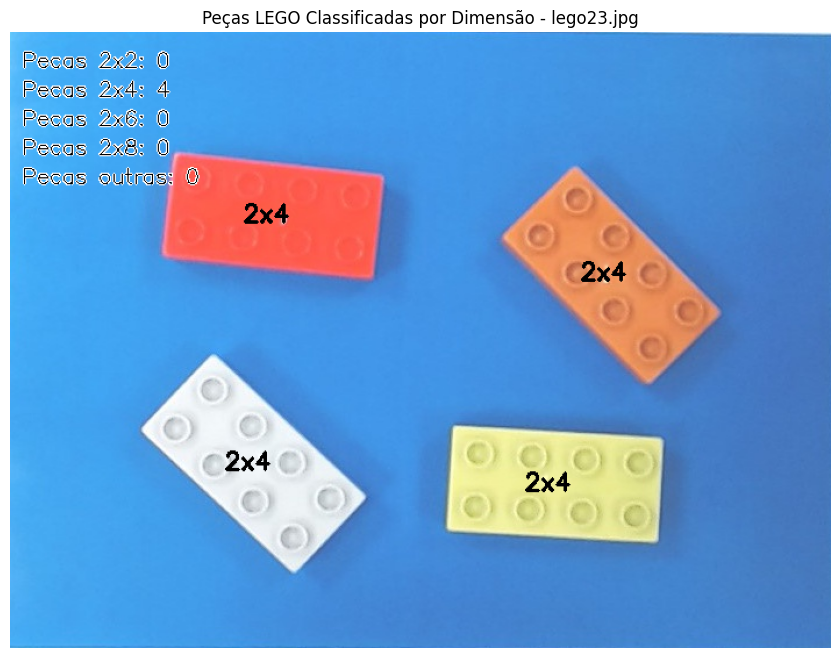

imagem: lego25.jpg


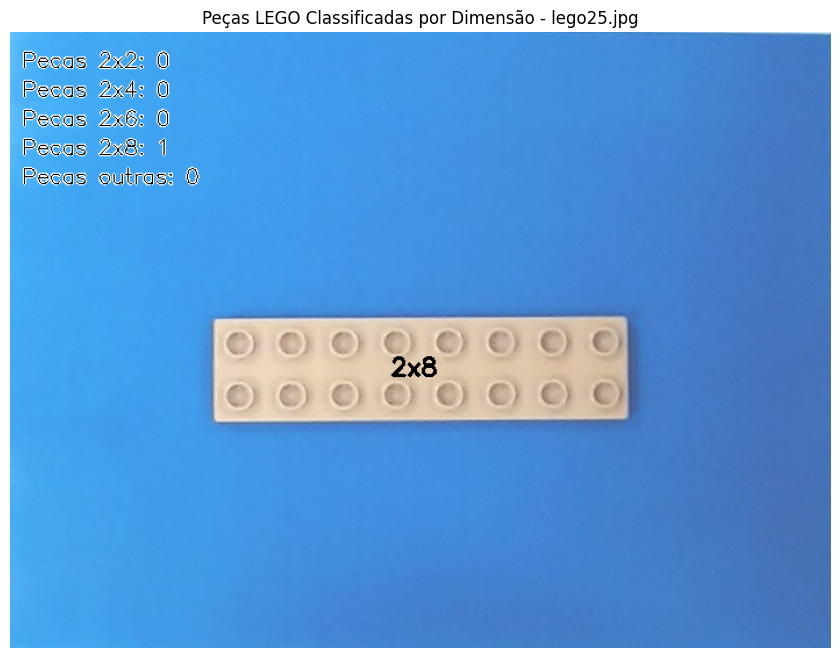

imagem: lego30.jpg


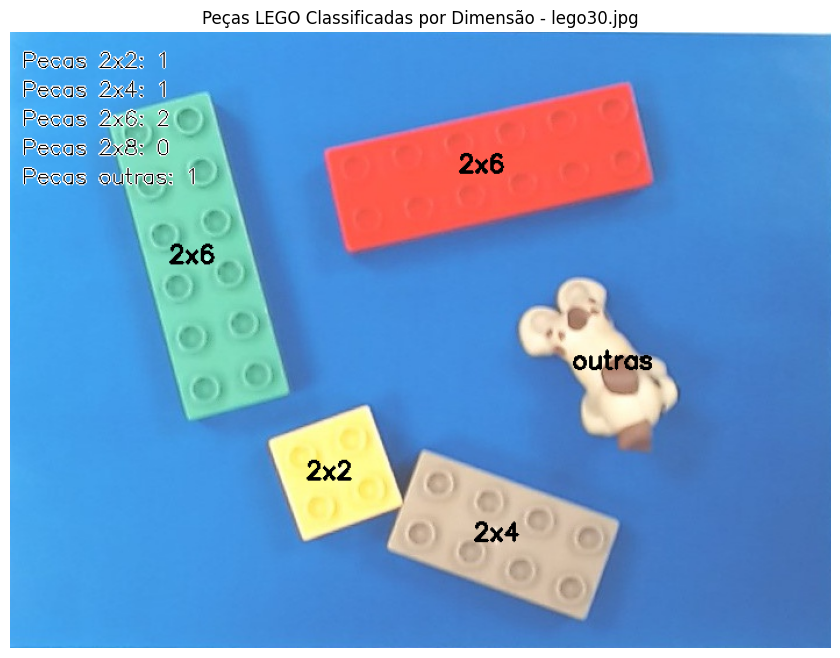

imagem: lego32.jpg


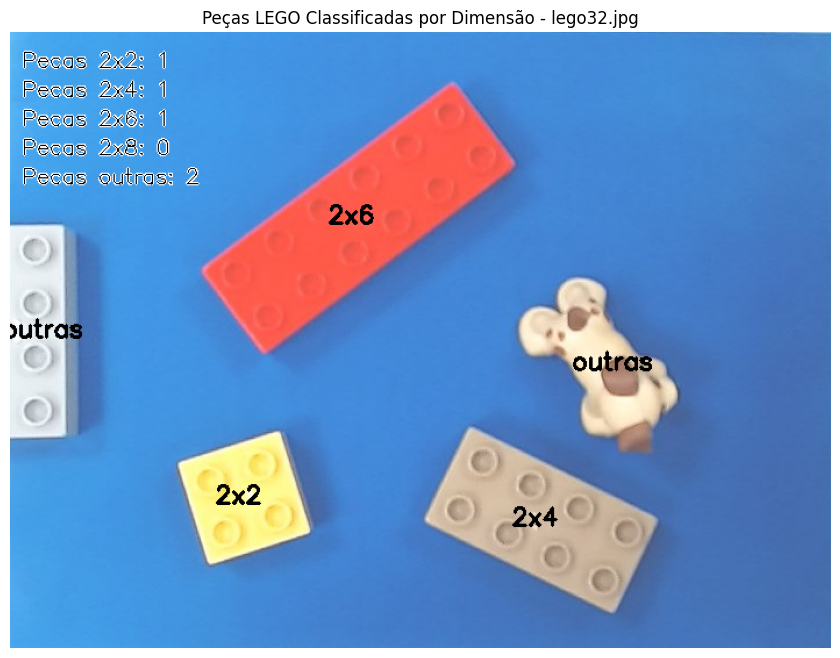

In [20]:
def classificar_pecas(img, approximated_contours, areas_peças, img_name):
    """
    Função que classifica as peças LEGO baseando-se no número de vértices e área.
    
    Parâmetros:
        img: Imagem original
        approximated_contours: Lista de contornos aproximados poligonalmente
        areas_peças: Lista com as áreas de cada peça/contorno
        img_name: Nome do ficheiro de imagem
        
    Retorna:
        dims_dict: Dicionário com a contagem de cada tipo de peça
        img_with_labels: Imagem com as classificações desenhadas
    """
    
    # obter dimensões da imagem
    img_height, img_width = img.shape[:2]
    
    # criar uma cópia da imagem para escrever as dimensões
    img_with_labels = img.copy()

    # reset ao dicionário para contar corretamente
    dims_dict = {"2x2": 0, "2x4": 0, "2x6": 0, "2x8": 0, "outras": 0}

    # classificação das peças com base na área e número de vértices
    for i, (approx_contour, area) in enumerate(zip(approximated_contours, areas_peças)):
        num_vertices = len(approx_contour)

        if area == 0:
            continue
        
        # verificar se a peça está na borda
        esta_na_borda = verifica_peca_na_borda(approx_contour, img_width, img_height)
        
        # se está na borda ou não tem 4 vértices -> classificar como "outras"
        if esta_na_borda or num_vertices != 4:
            dimensao = "outras"
        else:
            # classificar baseado na área (apenas para peças não cortadas e que têm 4 vértices)
            if area >= 4700 and area < 8000:
                dimensao = "2x2"
            elif area >= 9500 and area < 13500:
                dimensao = "2x4"
            elif area >= 13500 and area < 20500:
                dimensao = "2x6"
            elif area >= 20500:
                dimensao = "2x8"
            else:
                dimensao = "outras"
        
        # incrementar o contador no dicionário
        dims_dict[dimensao] += 1
        
        # encontrar o centróide do contorno para escrever a dimensão
        M = cv.moments(approx_contour)
        if M["m00"] != 0:
            cx = int(M["m10"] / M["m00"])
            cy = int(M["m01"] / M["m00"])
            
            # escrever a dimensão no centro da peça
            cv.putText(img_with_labels, dimensao, (cx-25, cy+5), 
                       cv.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 0), 2)

    # escrever a contagem das peças no canto superior esquerdo da imagem
    y_offset = 30
    for i, (tipo, quantidade) in enumerate(dims_dict.items()):
        texto = f"Pecas {tipo}: {quantidade}"
        cv.putText(img_with_labels, texto, (10, y_offset + i * 25), 
                   cv.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)
        # contorno preto para se ler melhor
        cv.putText(img_with_labels, texto, (10, y_offset + i * 25), 
                   cv.FONT_HERSHEY_SIMPLEX, 0.6, (0, 0, 0), 1)

    # mostrar a imagem final com as classificações
    plt.figure(figsize=(12, 8))
    plt.imshow(img_with_labels[..., ::-1])
    plt.title(f'Peças LEGO Classificadas por Dimensão - {img_name}')
    plt.axis('off')
    plt.show()
    
    return dims_dict, img_with_labels

# dicionários para guardar os resultados da classificação
classificacao_dict = {}
img_with_labels_dict = {}

for img_name in image_files:
    print(f"imagem: {img_name}")
    # obter a imagem original correspondente
    img = leitura_imagem(img_name)
    # usar os contornos aproximados e áreas corretos para esta imagem
    dims_dict, img_with_labels = classificar_pecas(img, approximated_contours_dict[img_name], areas_pecas_dict[img_name], img_name)
    
    # guardar nos dicionários
    classificacao_dict[img_name] = dims_dict
    img_with_labels_dict[img_name] = img_with_labels

### Justificação do código

A função `classificar_pecas` implementa um **algoritmo de classificação** que primeiro verifica o número de vértices e se uma peça está nas bordas da imagem, e depois aplica limiares de área para categorizar as peças LEGO válidas nas suas respetivas dimensões.

O primeiro critério de classificação é então o **número de vértices**. Peças de LEGO retangulares ou quadrangulares devem ter exatamente **4 vértices** após a aproximação poligonal. Qualquer outro tipo de peças, será classificado como `outras`

Para tratar peças que **tocam as bordas** da imagem, implementou-se a função `verifica_peca_na_borda` baseado num **limiar de proximidade (`border_threshold = 10`)**. Este método funciona calculando o retângulo delimitador de cada contorno através do `cv.boundingRect()` e verifica se qualquer uma das suas extremidades (esquerda, direita, superior ou inferior) se encontra a uma distância inferior a 10 píxeis das bordas da imagem, classificando automaticamente essas peças como "outras" para evitar medições incorretas de área em peças parcialmente visíveis.

Os **limiares de área** foram definidos através da análise das imagens de treino, sendo as peças de **2x2** = 4700 -> 8000 píxeis de área; as de **2x4** = 9500 -> 13500 píxeis de área; as de **2x6** = 13500 -> 20500 píxeis de área; e as peças de **2x8** >= 20500 píxeis de área.

A função gera, no final, uma imagem que contém cada peça rotulada com sua dimensão no centróide, calculado através dos **momentos de imagem (`cv.moments`)** e contém o resumo no canto superior esquerdo com o total de cada tipo de peça.

## **Conclusão**

Os resultados obtidos demonstram que o algoritmo até aqui desenvolvido funciona bem com as imagens de treino disponibilizadas pelo docente, concluindo assim que os objetivos propostos foram alcançados de forma satisfatória.

## **Bibliografia**

OpenCV - https://opencv.org

OpenCV Documentation - https://docs.opencv.org/4.x/index.html

GeeksforGeeks | OpenCV Tutorial in Python - https://www.geeksforgeeks.org/python/opencv-python-tutorial